# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [15]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [16]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [19]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - torch.ones_like(gradient_norm))**2)
    #### END CODE HERE ####
    return penalty

In [20]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [21]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [22]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [26]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = - torch.mean((crit_real_pred - crit_fake_pred)) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [27]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.10336935238912702, critic loss: 1.9365547799170013


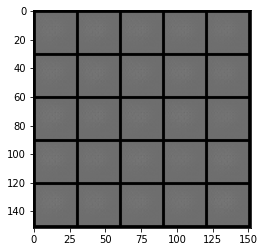

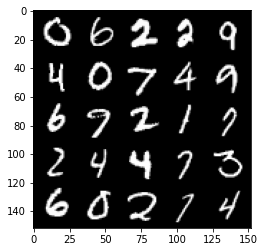

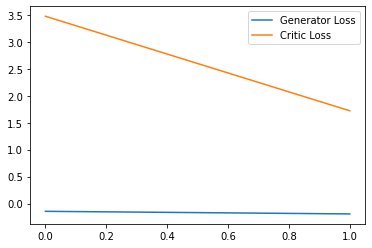

Step 100: Generator loss: 1.0295250153541564, critic loss: -1.8791454534530638


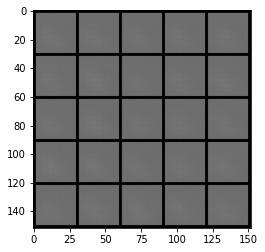

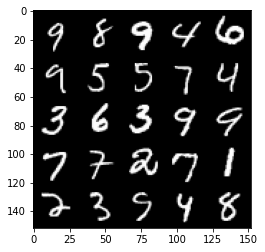

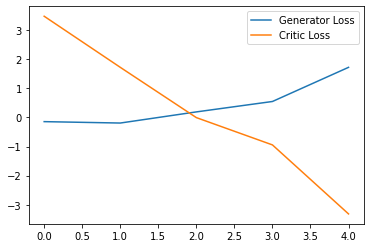

Step 150: Generator loss: 2.4808920073509215, critic loss: -10.200572238922119


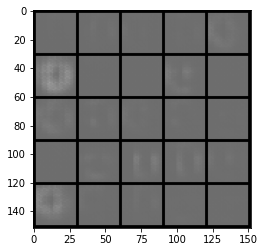

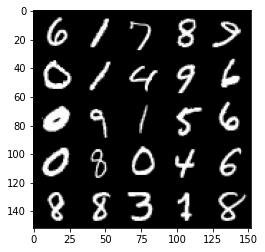

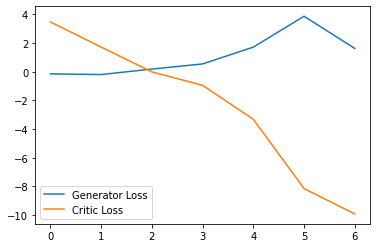

Step 200: Generator loss: 0.6899468443542719, critic loss: -26.78295824432374


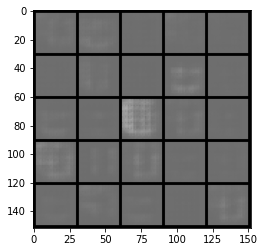

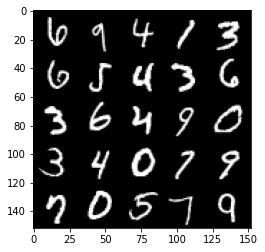

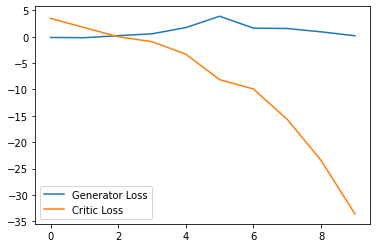

Step 250: Generator loss: -1.1215479223430156, critic loss: -57.528066116333


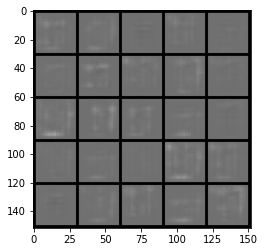

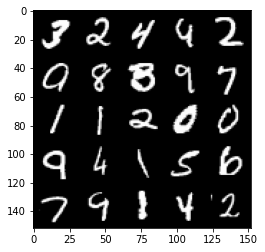

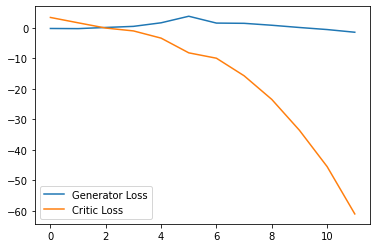

Step 300: Generator loss: 0.33102875024080275, critic loss: -103.03299987792968


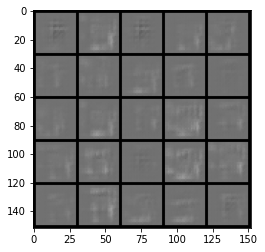

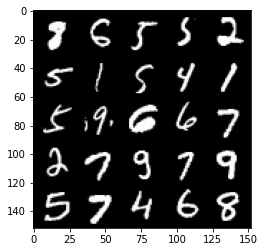

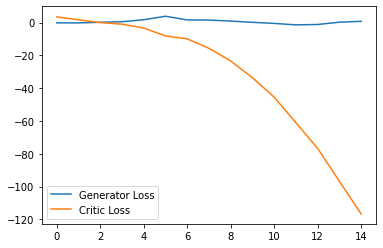

Step 350: Generator loss: -1.4598104616999625, critic loss: -146.11837515258787


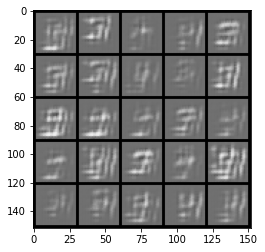

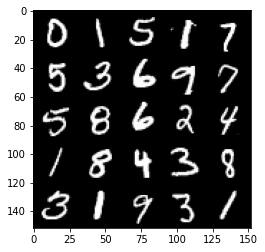

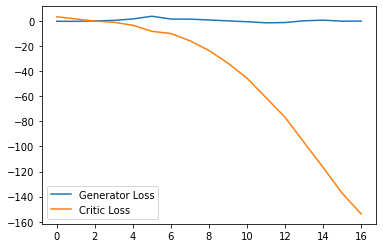

Step 400: Generator loss: -12.625899994373322, critic loss: -133.0547300872803


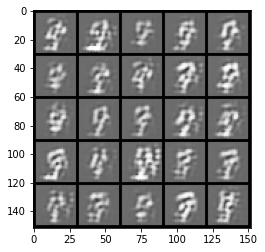

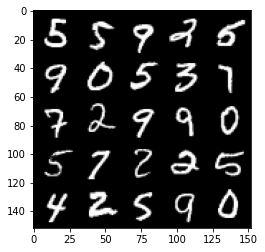

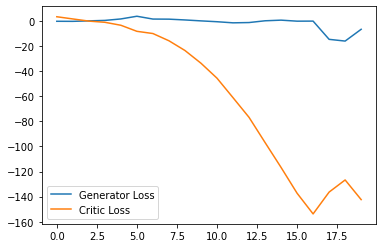

Step 450: Generator loss: 4.384441154003143, critic loss: -207.24692041015624


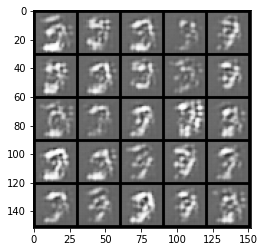

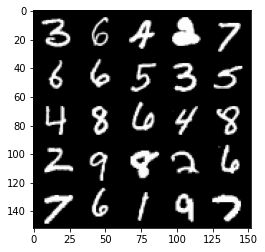

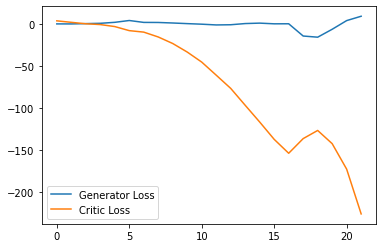

Step 500: Generator loss: -19.394238963127137, critic loss: -175.32178457641595


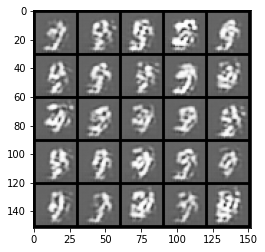

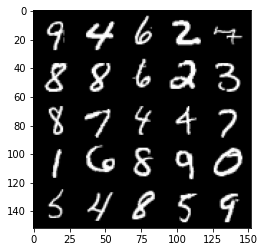

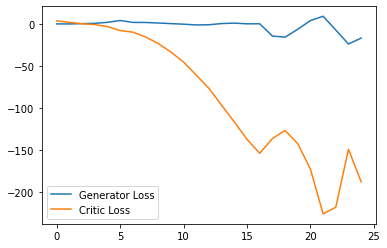

Step 550: Generator loss: -0.16642321586608888, critic loss: -236.47734725952145


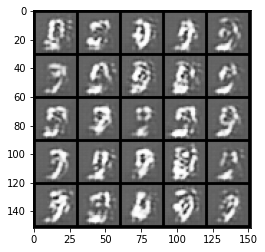

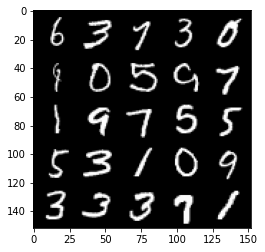

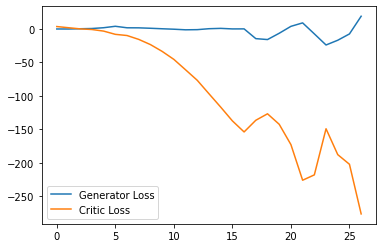

Step 600: Generator loss: 1.0617196542024612, critic loss: -255.2069539642334


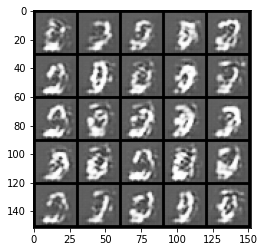

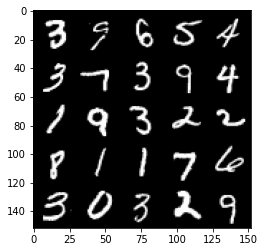

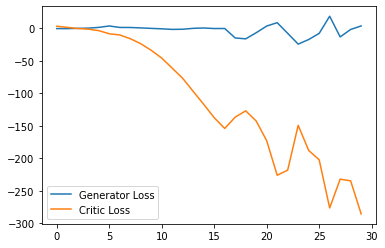

Step 650: Generator loss: -20.8390762424469, critic loss: -251.28769439697265


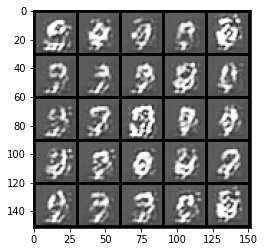

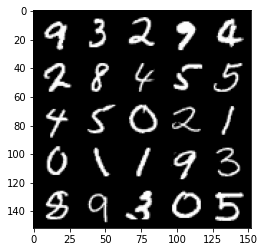

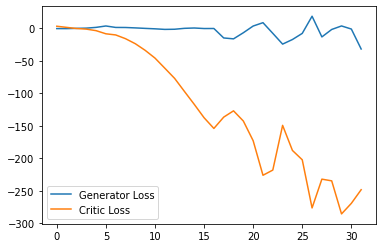

Step 700: Generator loss: -18.059472118616103, critic loss: -240.89599783325195


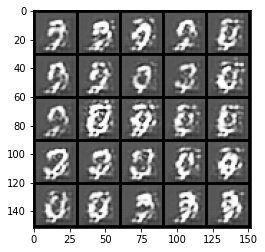

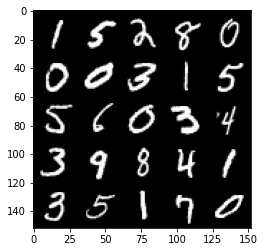

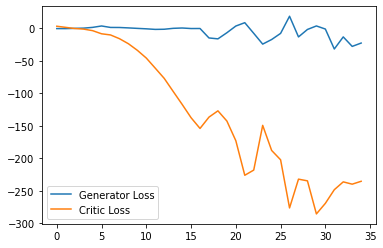

Step 750: Generator loss: -21.17947170138359, critic loss: -263.8081381225586


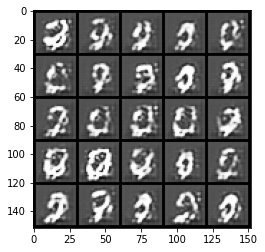

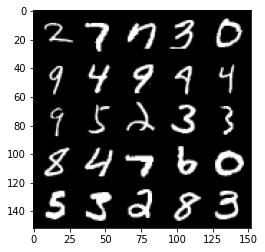

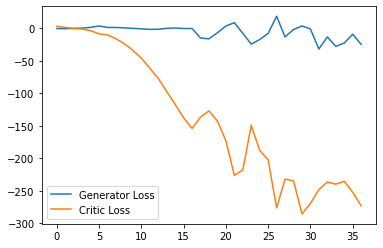

Step 800: Generator loss: -52.042833094596865, critic loss: -201.34078974914556


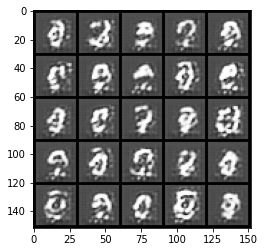

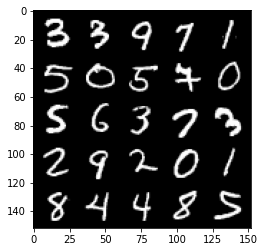

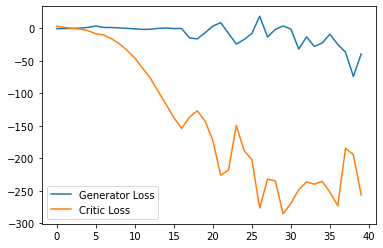

Step 850: Generator loss: -49.470137051939965, critic loss: -215.0779513854981


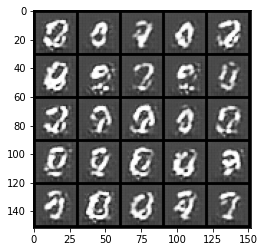

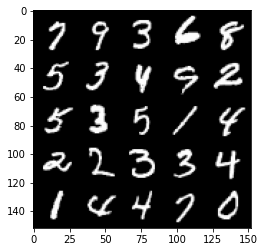

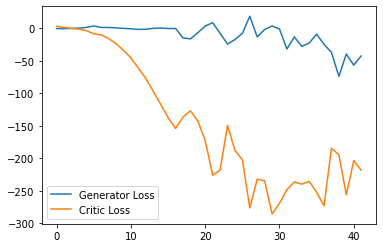

Step 900: Generator loss: -46.31112924337387, critic loss: -182.36388948059084


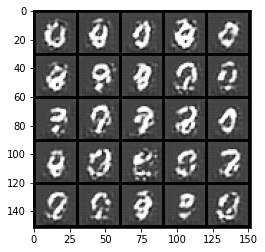

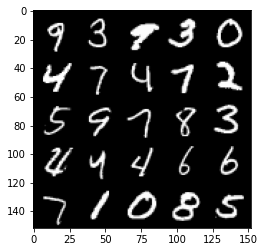

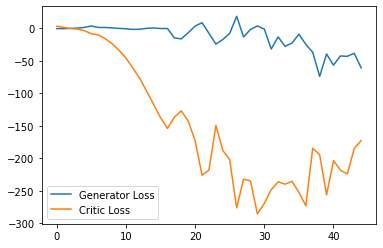

Step 950: Generator loss: -44.82754860937595, critic loss: -196.4918249588012


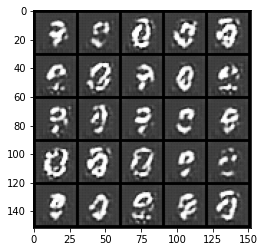

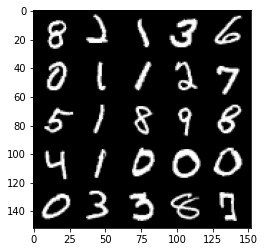

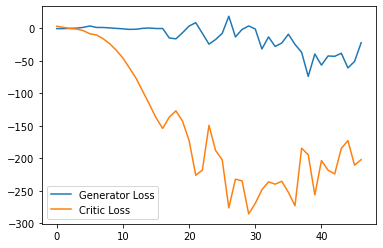

Step 1000: Generator loss: -49.78155984163284, critic loss: -133.1472682037354


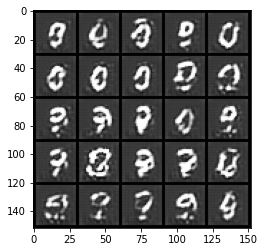

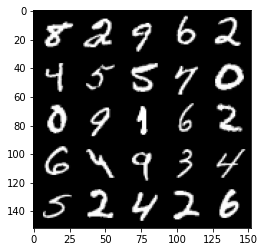

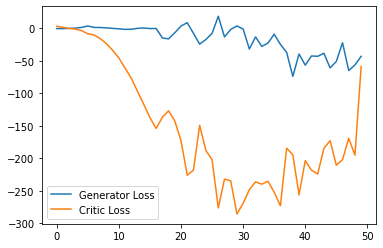

Step 1050: Generator loss: -4.676788559705019, critic loss: 8.613212852478027


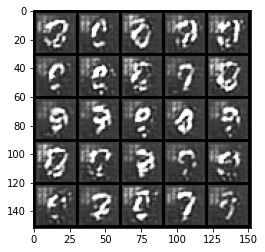

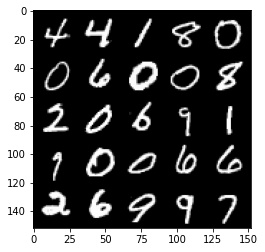

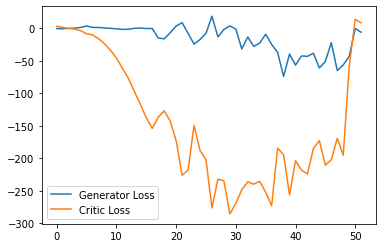

Step 1100: Generator loss: -40.947083473205566, critic loss: -29.567174346923824


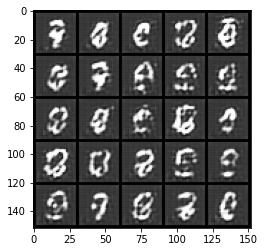

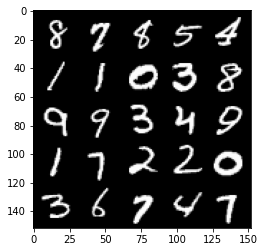

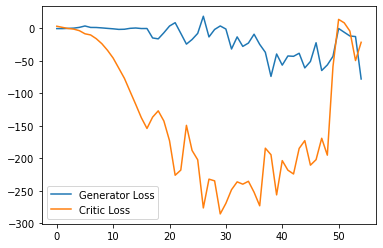

Step 1150: Generator loss: -120.23535766601563, critic loss: -27.6921381072998


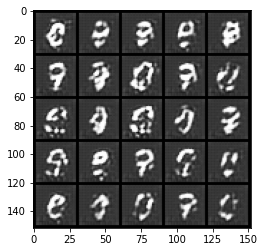

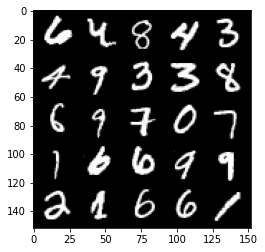

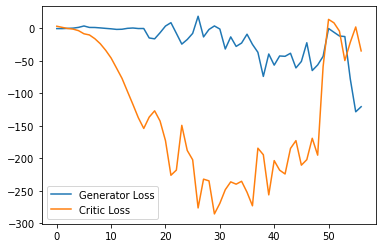

Step 1200: Generator loss: -90.7200413131714, critic loss: -86.519590965271


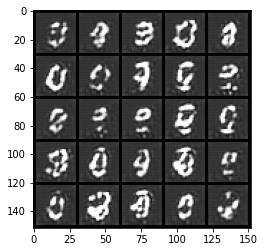

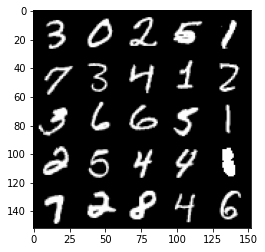

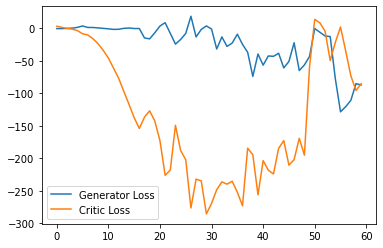

Step 1250: Generator loss: -86.36457382202148, critic loss: -100.74240739059445


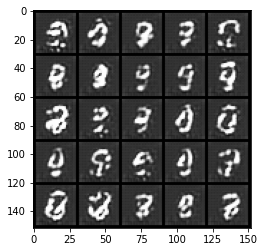

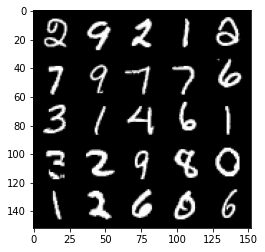

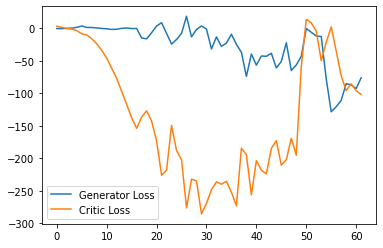

Step 1300: Generator loss: -94.98233898162842, critic loss: -73.86815289306638


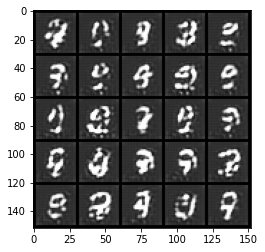

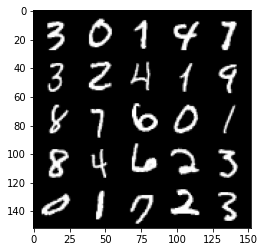

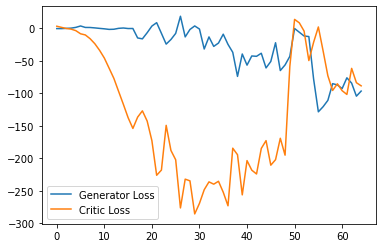

Step 1350: Generator loss: -83.87559129714965, critic loss: -87.54649906158447


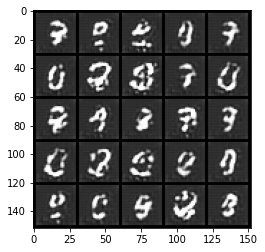

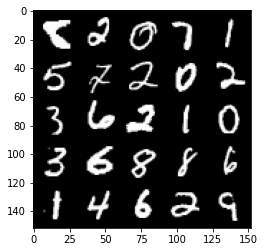

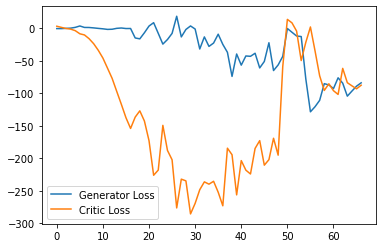

Step 1400: Generator loss: -66.06067932128906, critic loss: -100.93078195953368


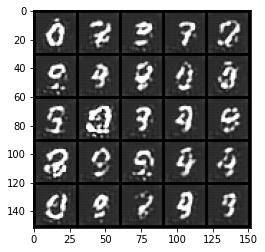

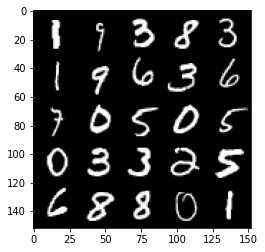

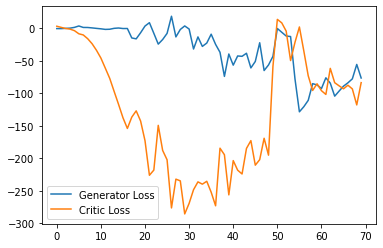

Step 1450: Generator loss: -66.32311693191528, critic loss: -83.2363617324829


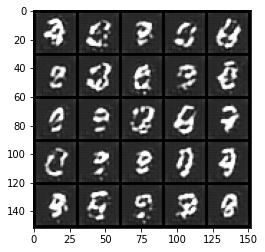

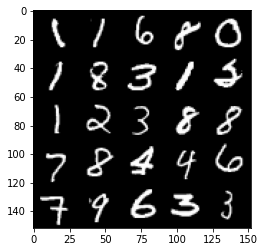

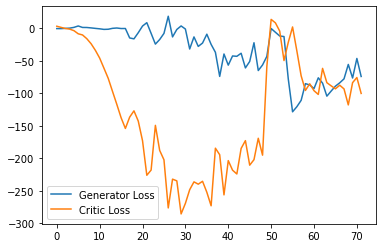

Step 1500: Generator loss: -65.16217063903808, critic loss: -57.45813866424559


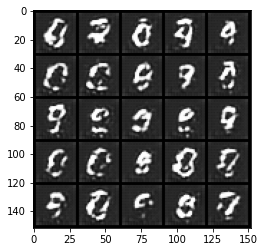

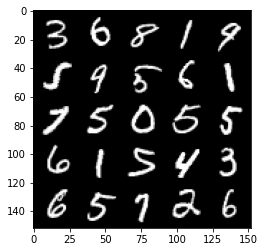

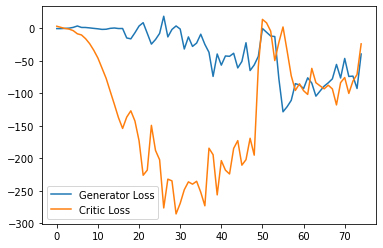

Step 1550: Generator loss: -55.652494716644284, critic loss: -36.87591834259034


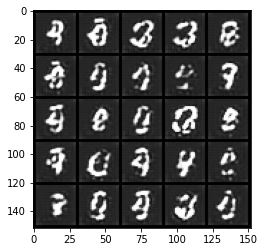

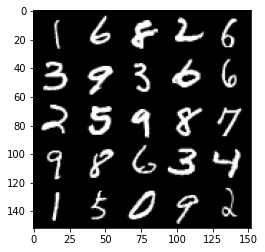

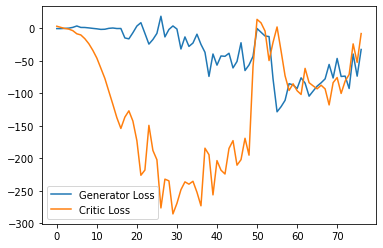

Step 1600: Generator loss: -64.75128350257873, critic loss: -46.970247615814195


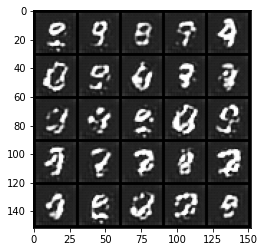

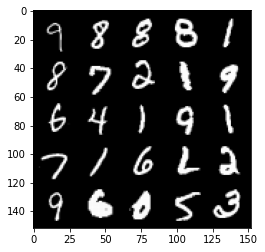

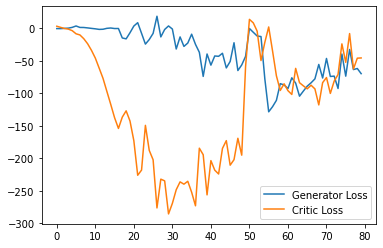

Step 1650: Generator loss: -41.573701820373536, critic loss: 13.86760356330872


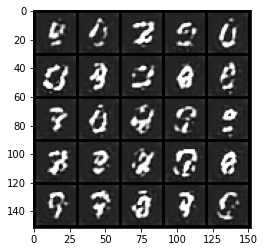

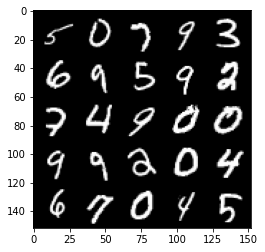

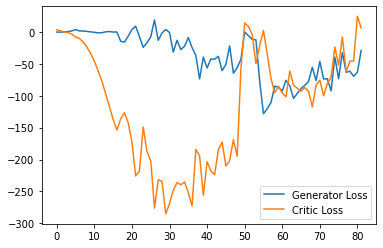

Step 1700: Generator loss: -24.88727409362793, critic loss: 4.80495371055603


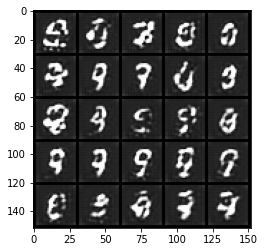

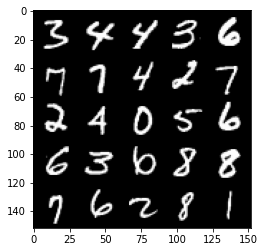

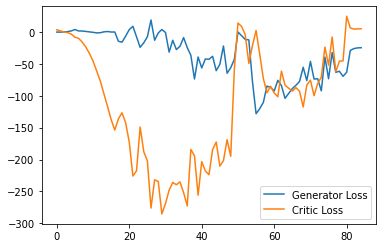

Step 1750: Generator loss: -25.987393341064454, critic loss: 4.927547831535338


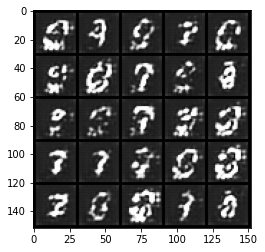

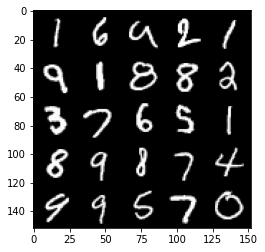

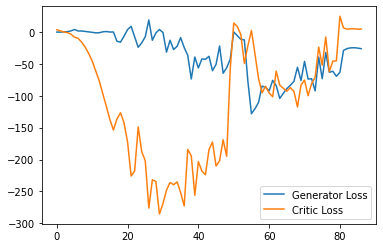

Step 1800: Generator loss: -27.472125396728515, critic loss: 4.6485547428131095


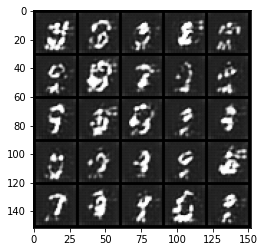

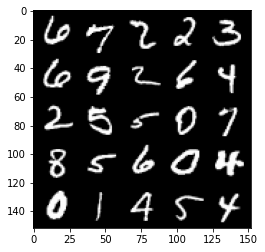

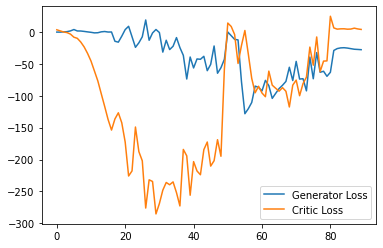

Step 1850: Generator loss: -28.372176361083984, critic loss: 2.4115350008010865


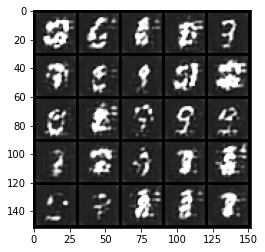

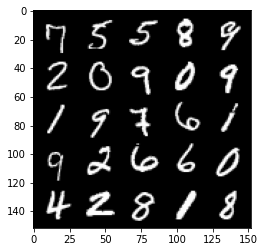

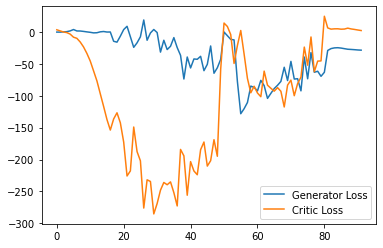

Step 1900: Generator loss: -28.22929962158203, critic loss: 1.3569782729148863


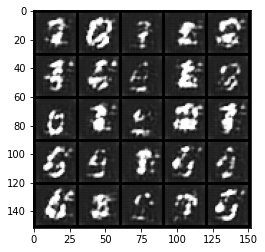

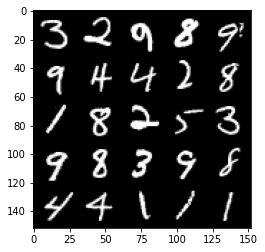

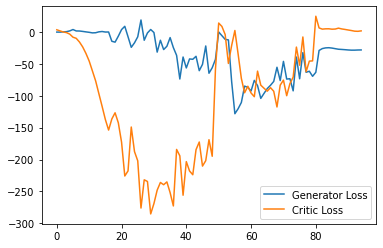

Step 1950: Generator loss: -28.434234657287597, critic loss: 2.4983817243576047


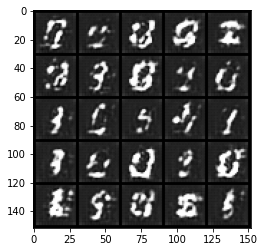

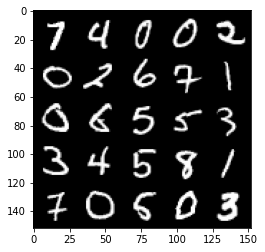

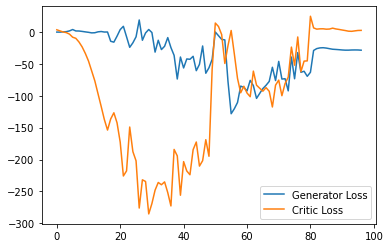

Step 2000: Generator loss: -28.850233535766602, critic loss: 1.5168676748275758


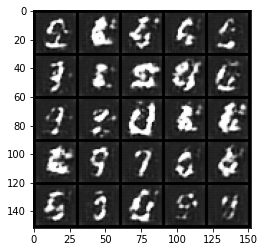

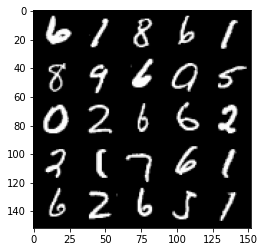

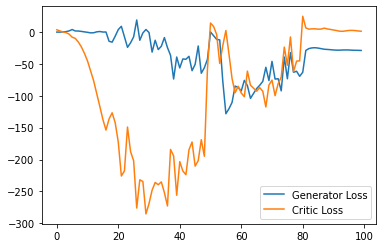

Step 2050: Generator loss: -29.052907371520995, critic loss: 0.41370473146438597


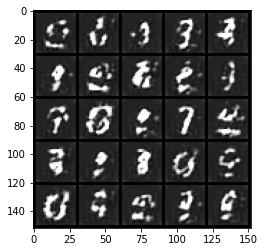

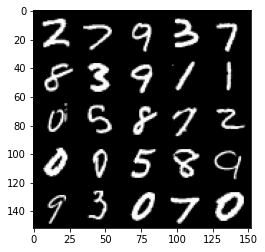

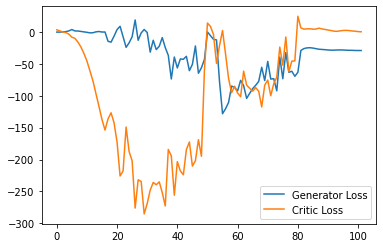

Step 2100: Generator loss: -29.181167984008788, critic loss: 0.10825101900100705


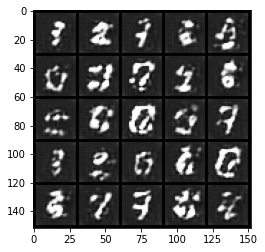

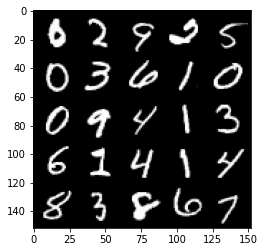

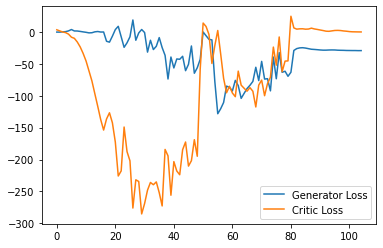

Step 2150: Generator loss: -28.954290657043458, critic loss: -0.32847694540023803


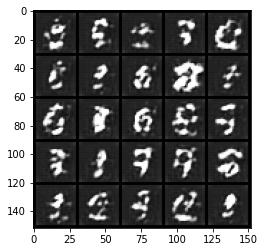

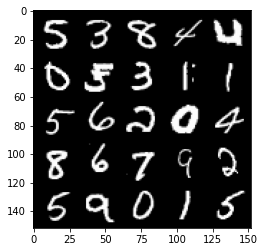

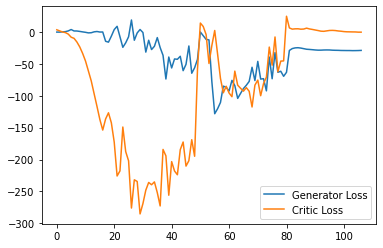

Step 2200: Generator loss: -28.539494934082033, critic loss: -0.4198527870178223


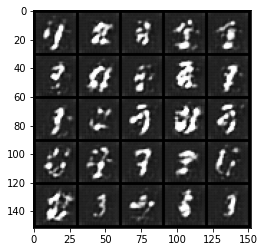

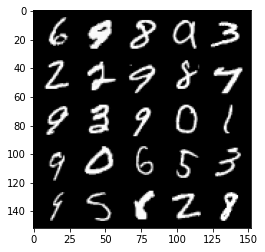

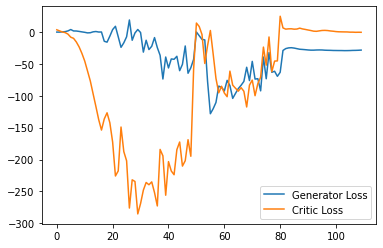

Step 2250: Generator loss: -28.06154987335205, critic loss: -0.7941008648872376


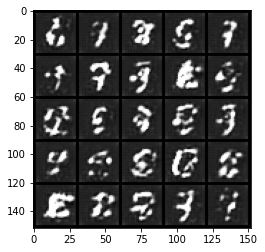

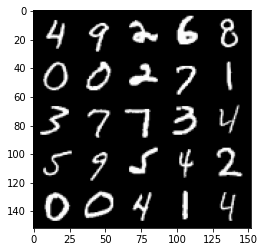

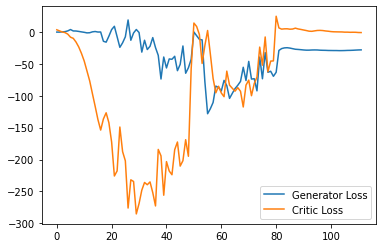

Step 2300: Generator loss: -27.54492893218994, critic loss: -1.0237345075607303


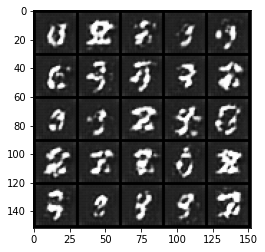

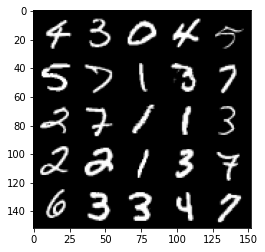

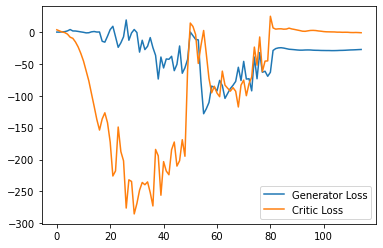

Step 2350: Generator loss: -26.933868598937988, critic loss: -1.6617408103942872


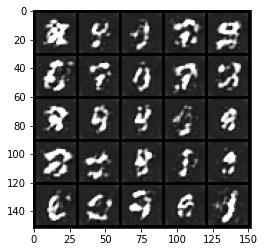

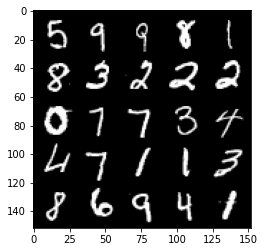

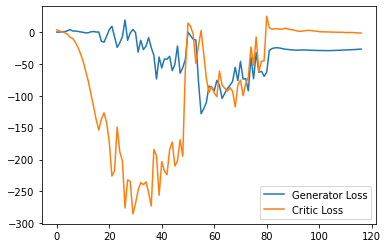

Step 2400: Generator loss: -28.368702392578125, critic loss: -2.3344289035797114


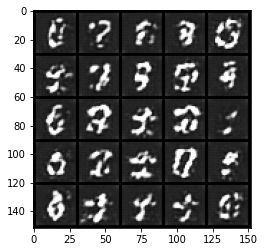

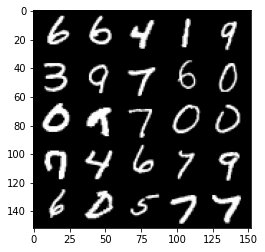

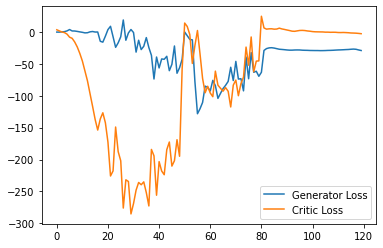

Step 2450: Generator loss: -30.35986671447754, critic loss: -4.432859977722168


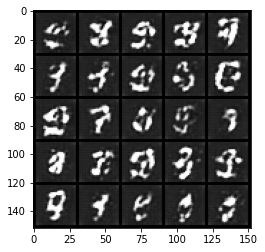

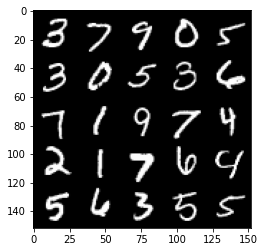

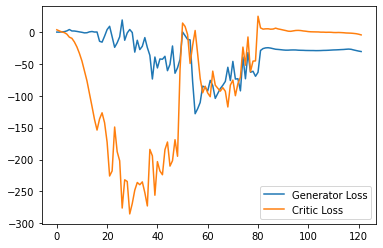

Step 2500: Generator loss: -36.98188488006592, critic loss: -7.0379309310913065


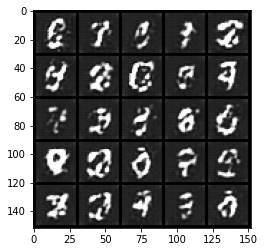

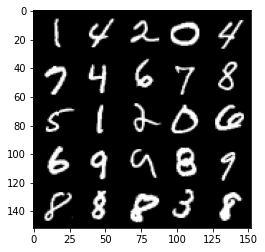

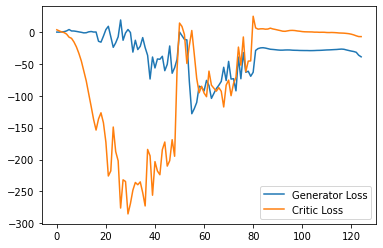

Step 2550: Generator loss: -42.85176597595215, critic loss: -8.793994323730471


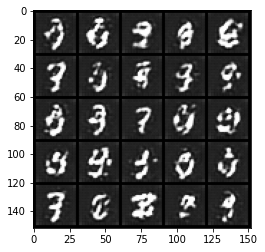

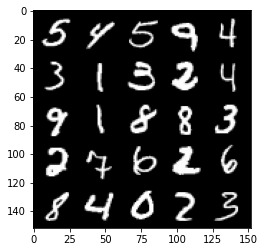

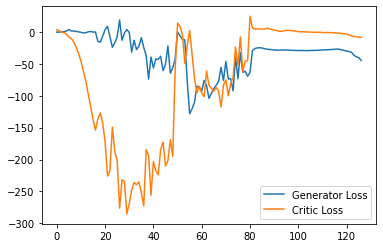

Step 2600: Generator loss: -45.144473228454586, critic loss: -11.586732267379762


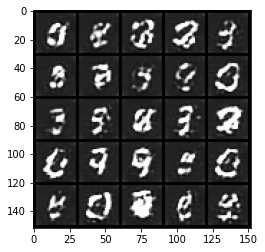

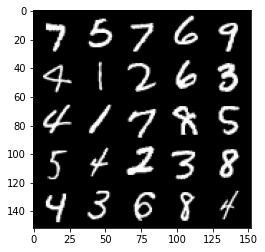

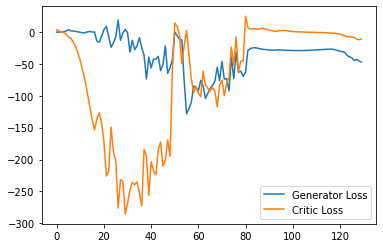

Step 2650: Generator loss: -46.698046875, critic loss: -14.05993325233459


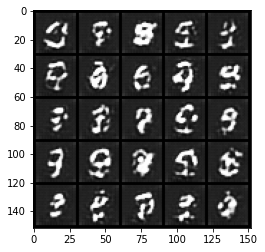

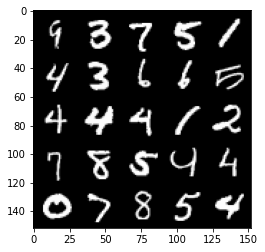

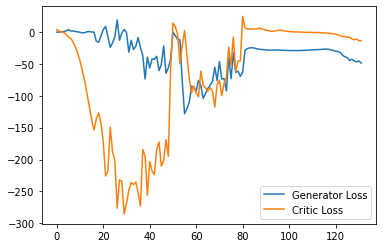

Step 2700: Generator loss: -45.41880905151367, critic loss: -15.958640544891363


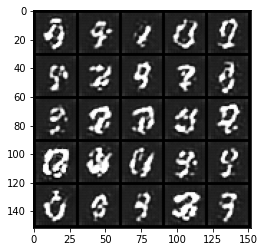

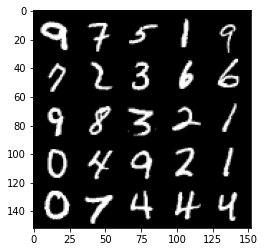

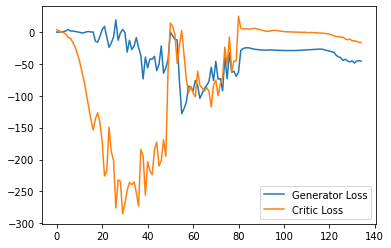

Step 2750: Generator loss: -45.77841690063477, critic loss: -15.864930000305174


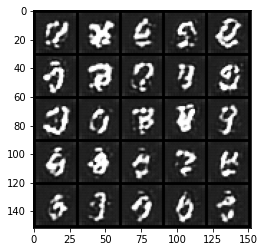

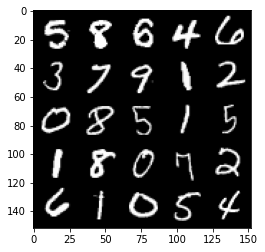

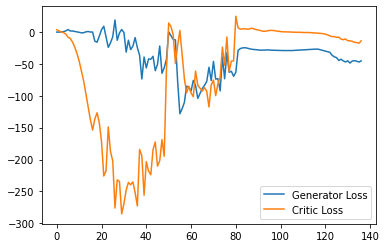

Step 2800: Generator loss: -43.61440734863281, critic loss: -7.470894332885742


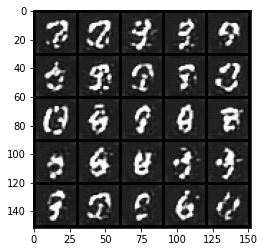

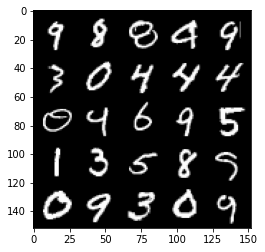

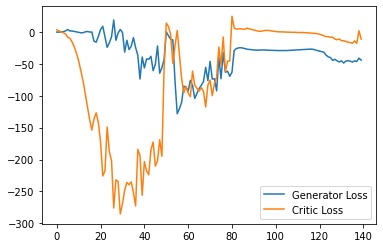

Step 2850: Generator loss: -45.405216674804684, critic loss: -16.21672477817536


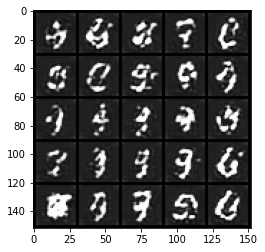

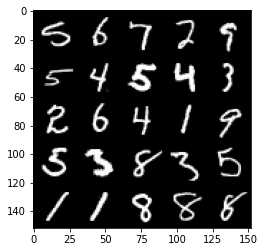

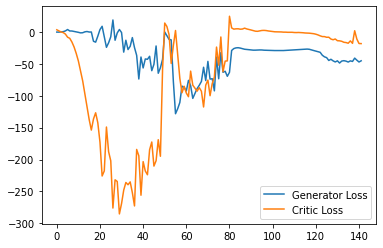

Step 2900: Generator loss: -48.119697265625, critic loss: -16.15561872291564


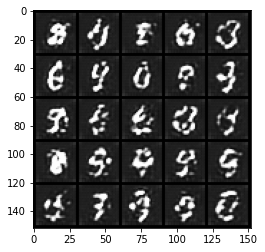

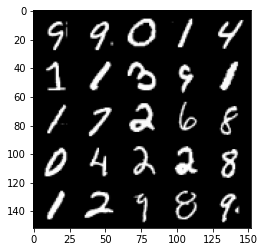

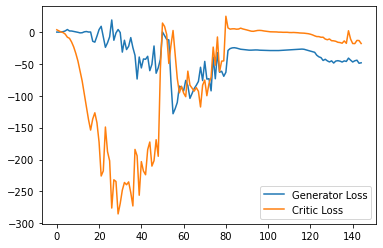

Step 2950: Generator loss: -47.984849548339845, critic loss: -19.445976379394537


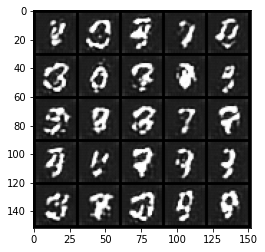

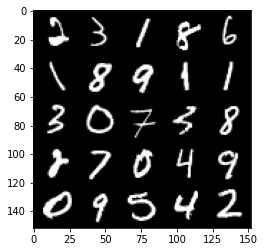

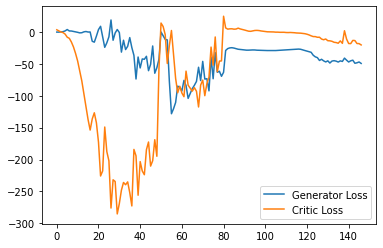

Step 3000: Generator loss: -43.68326477050781, critic loss: -19.11295869636535


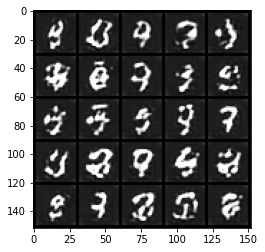

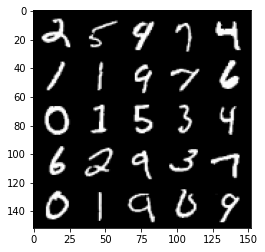

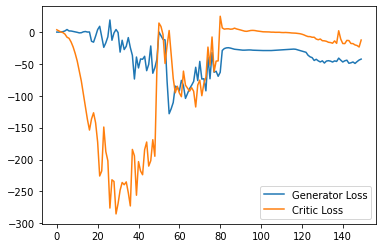

Step 3050: Generator loss: -41.49699542999267, critic loss: -11.447857029914854


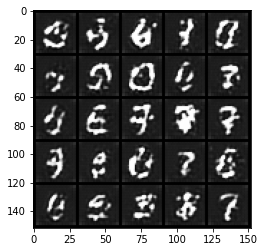

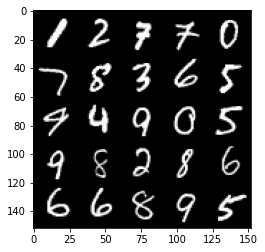

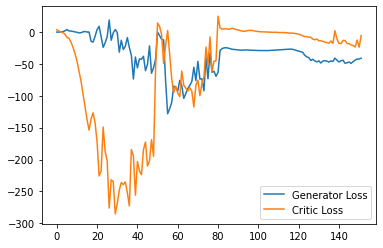

Step 3100: Generator loss: -41.48524017333985, critic loss: -2.125896113872528


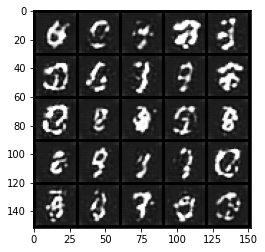

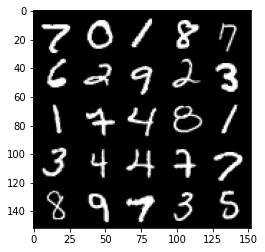

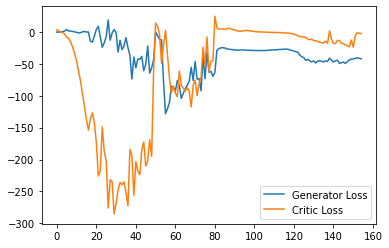

Step 3150: Generator loss: -44.02389350891113, critic loss: -3.076517922401428


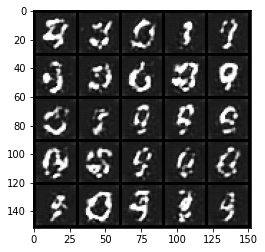

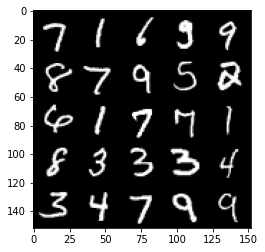

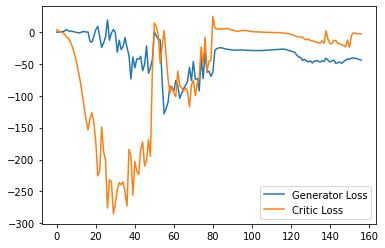

Step 3200: Generator loss: -50.382919006347656, critic loss: -12.388835540771488


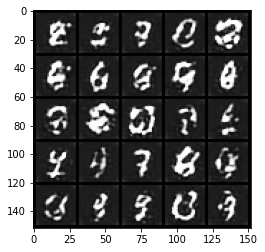

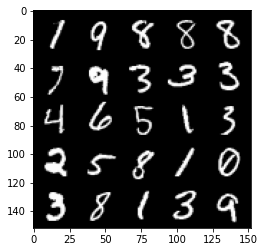

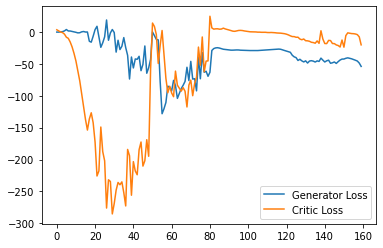

Step 3250: Generator loss: -51.8547819519043, critic loss: -20.763686614036565


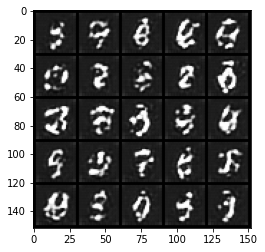

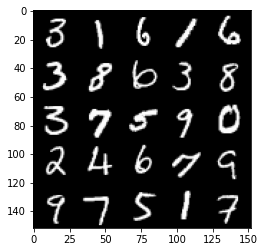

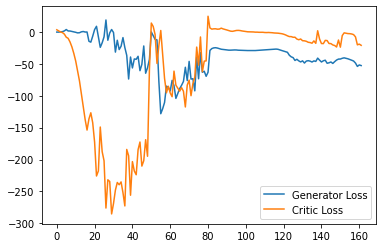

Step 3300: Generator loss: -50.41051452636719, critic loss: -23.05225469589233


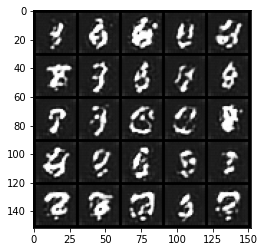

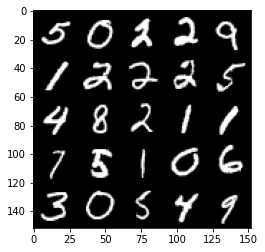

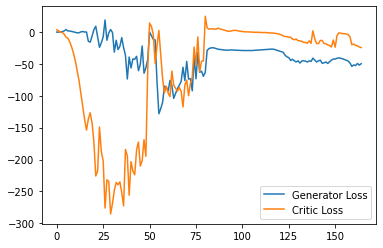

Step 3350: Generator loss: -45.91534343719482, critic loss: -15.411675457000731


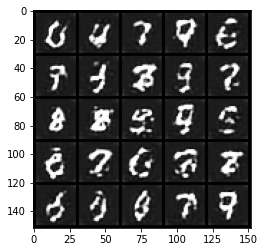

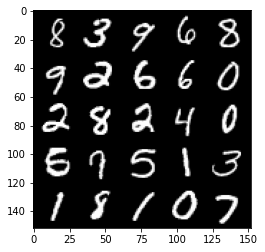

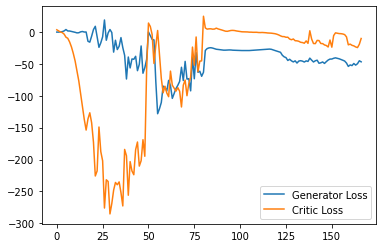

Step 3400: Generator loss: -48.81399993896484, critic loss: -21.055604022979736


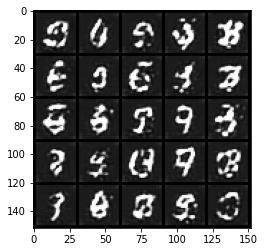

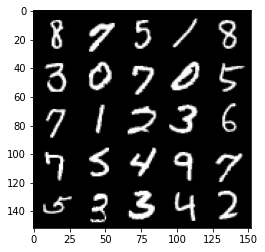

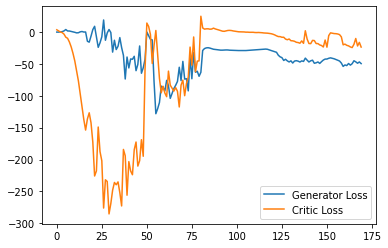

Step 3450: Generator loss: -47.43484302520752, critic loss: -20.11432946205139


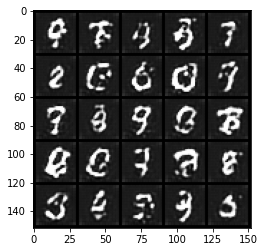

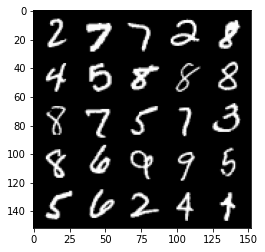

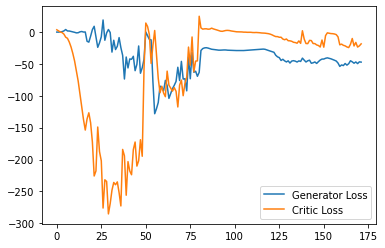

Step 3500: Generator loss: -48.13120574951172, critic loss: -23.195344137191764


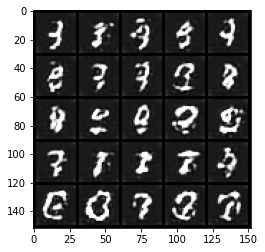

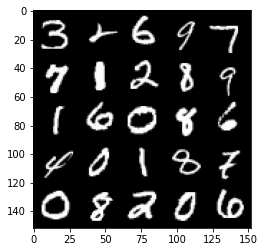

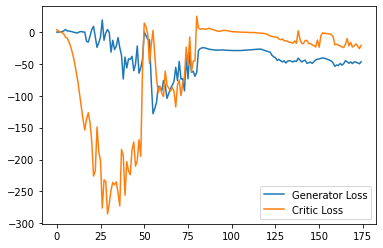

Step 3550: Generator loss: -46.3654248046875, critic loss: -22.703653512954713


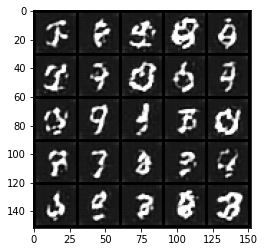

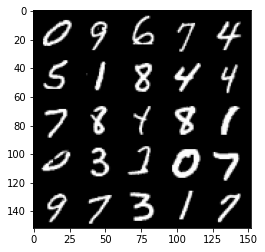

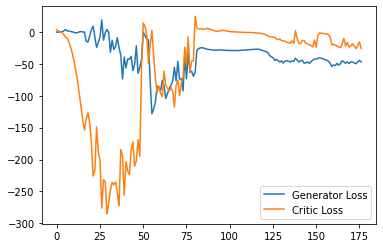

Step 3600: Generator loss: -45.15796821594238, critic loss: -22.53185954952239


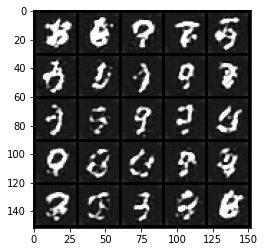

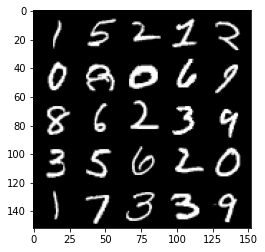

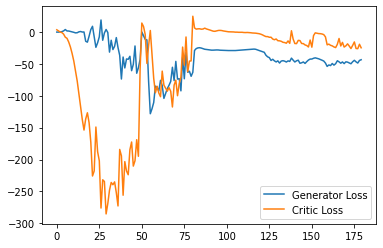

Step 3650: Generator loss: -44.16848079681397, critic loss: -21.83794716453553


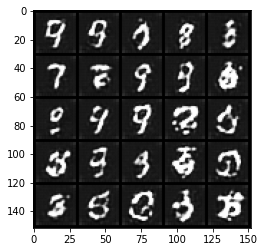

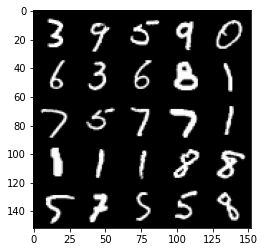

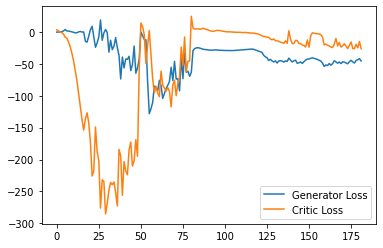

Step 3700: Generator loss: -42.29822334289551, critic loss: -20.03753444194794


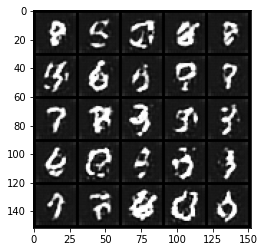

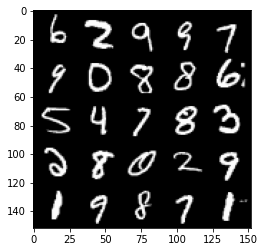

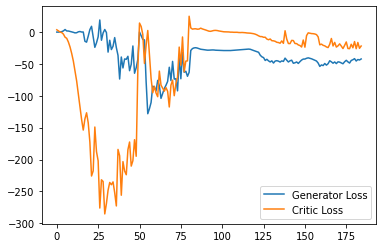

Step 3750: Generator loss: -41.43813320159912, critic loss: -20.936861899375913


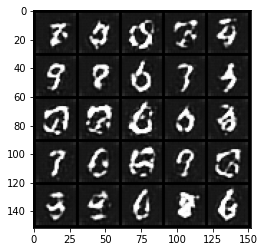

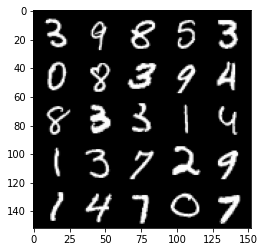

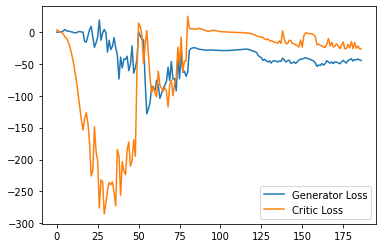

Step 3800: Generator loss: -42.14778759002686, critic loss: -23.94000927066804


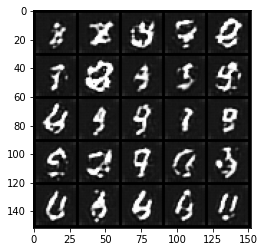

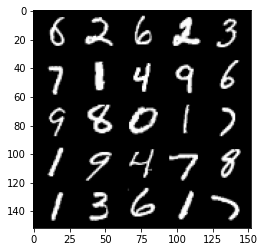

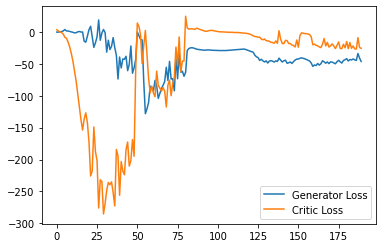

Step 3850: Generator loss: -38.912975363731384, critic loss: -14.413725560188295


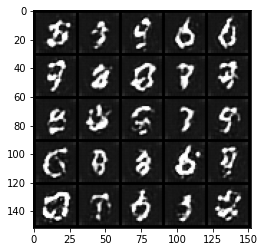

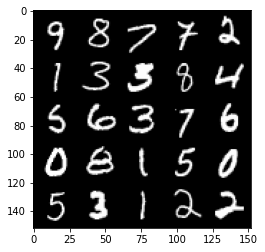

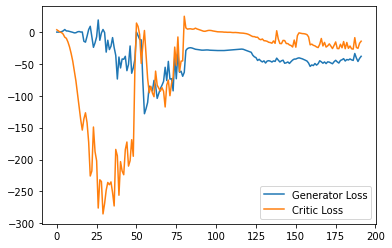

Step 3900: Generator loss: -43.54908298492432, critic loss: -23.67681029701232


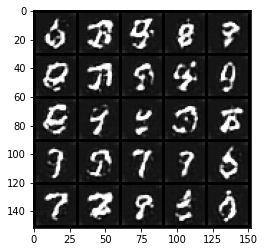

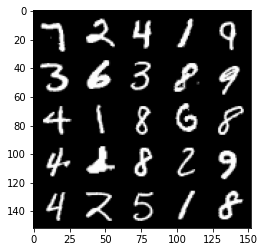

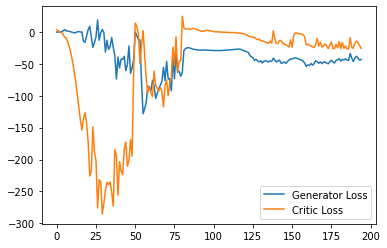

Step 3950: Generator loss: -36.019020614624026, critic loss: -7.244074168205262


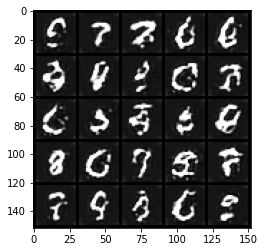

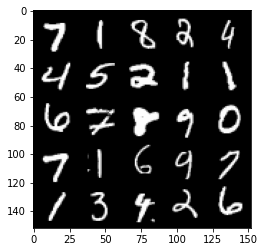

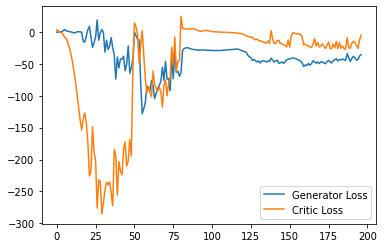

Step 4000: Generator loss: -40.811172790527344, critic loss: -13.892472578048704


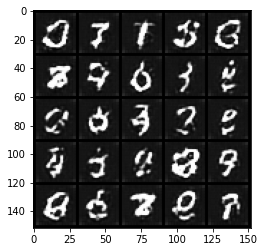

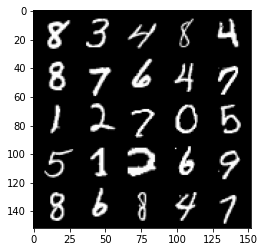

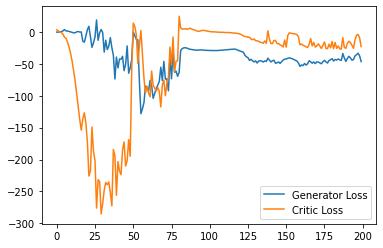

Step 4050: Generator loss: -37.04755535125732, critic loss: -7.471590720176696


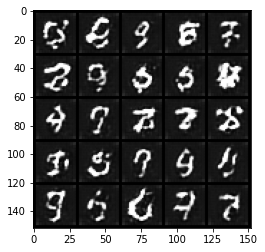

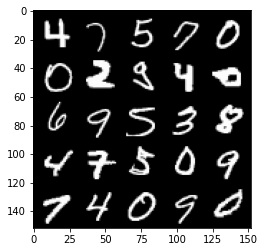

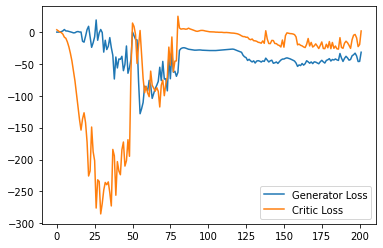

Step 4100: Generator loss: -38.645797882080075, critic loss: -8.550894744873045


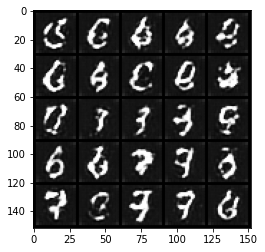

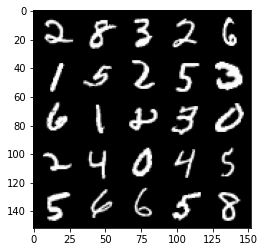

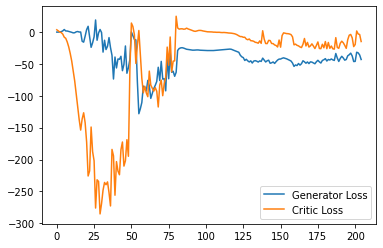

Step 4150: Generator loss: -45.90130355834961, critic loss: -21.786765797615047


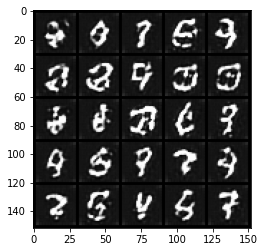

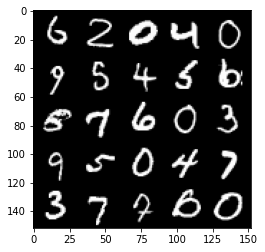

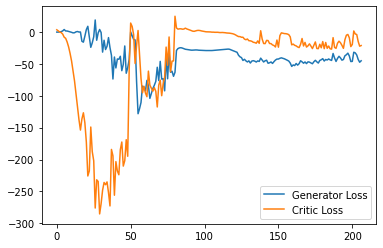

Step 4200: Generator loss: -35.94758819580078, critic loss: -4.896038968086241


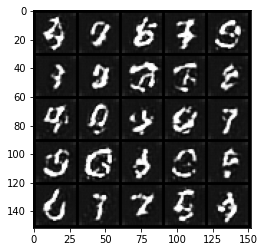

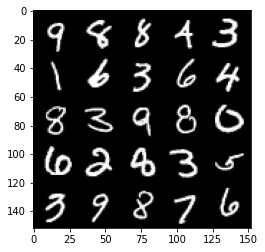

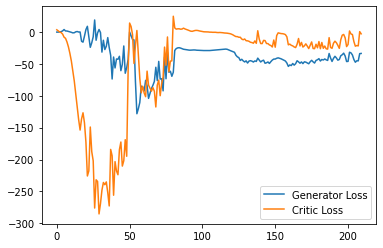

Step 4250: Generator loss: -39.45495475769043, critic loss: -9.663787747383118


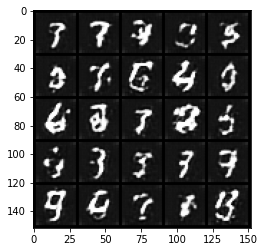

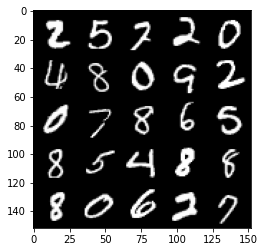

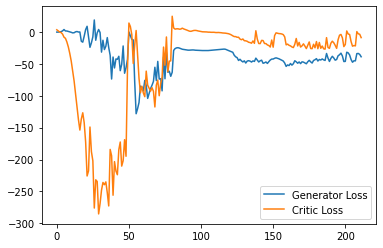

Step 4300: Generator loss: -39.98685234069824, critic loss: -12.050737900733942


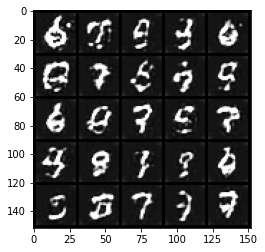

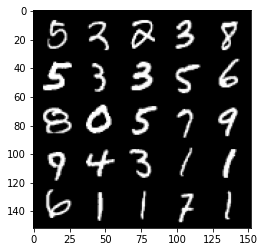

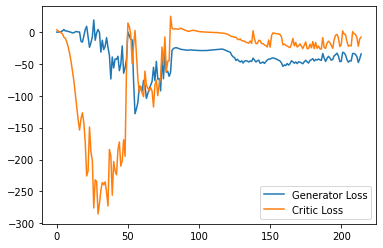

Step 4350: Generator loss: -42.93749561309814, critic loss: -24.46806504654884


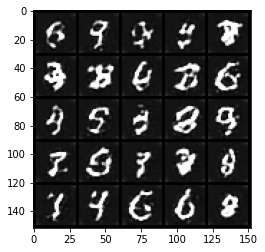

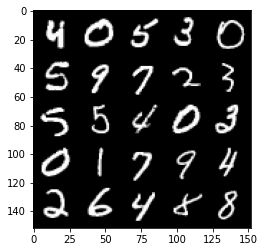

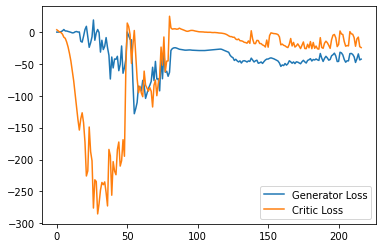

Step 4400: Generator loss: -38.01606605529785, critic loss: -12.146675696372993


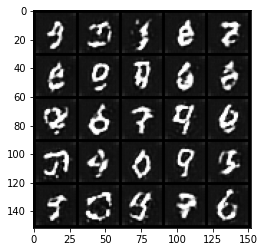

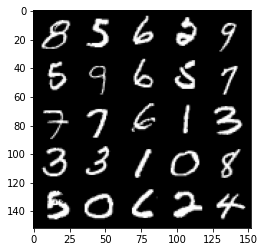

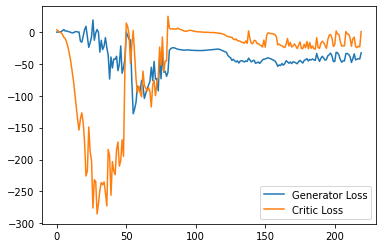

Step 4450: Generator loss: -34.424815063476565, critic loss: -10.23731911087036


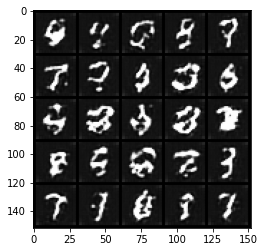

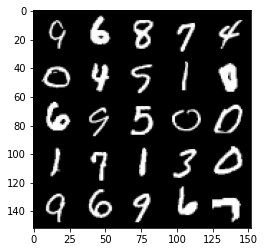

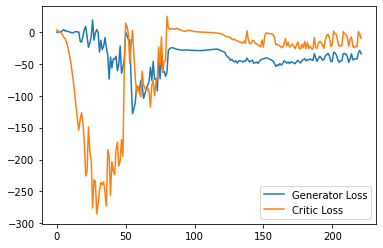

Step 4500: Generator loss: -41.97277877807617, critic loss: -21.85496281147003


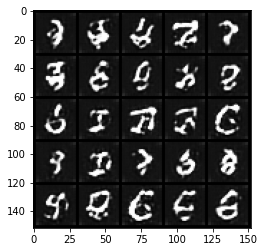

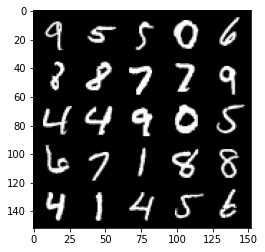

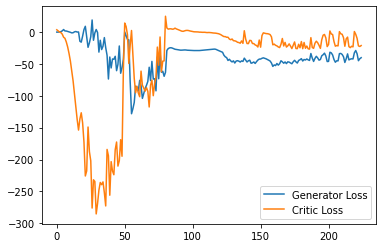

Step 4550: Generator loss: -34.864123573303225, critic loss: -16.706457097053534


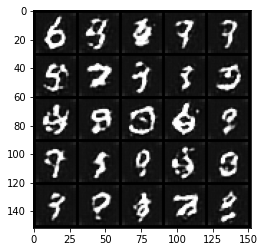

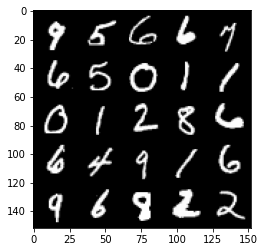

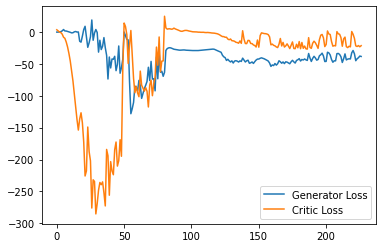

Step 4600: Generator loss: -29.305968742370606, critic loss: -5.4269393987655645


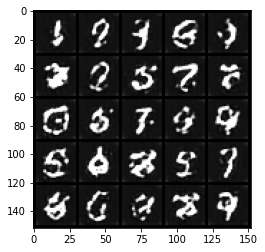

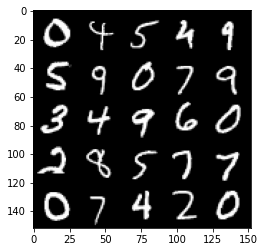

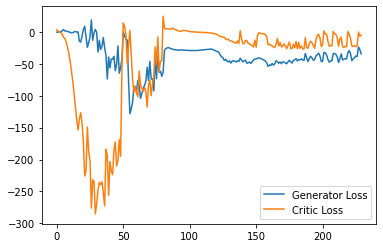

Step 4650: Generator loss: -25.164646072387697, critic loss: -2.3382989187240604


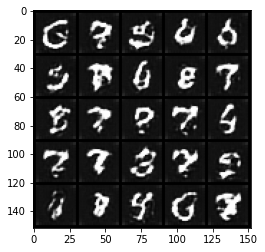

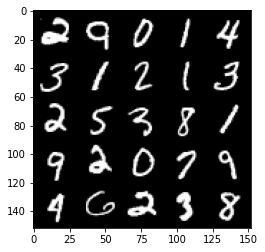

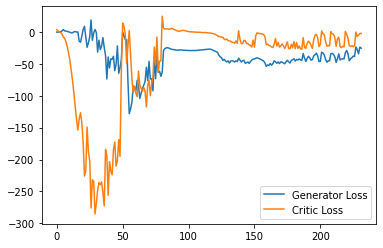

Step 4700: Generator loss: -28.824429473876954, critic loss: -3.455241159439087


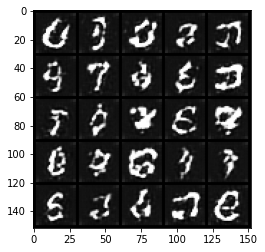

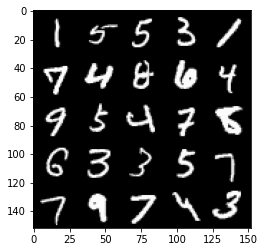

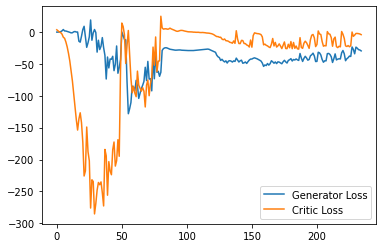

Step 4750: Generator loss: -36.282335662841795, critic loss: -14.427911880493157


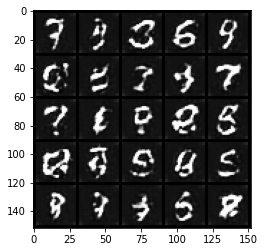

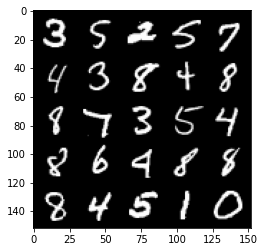

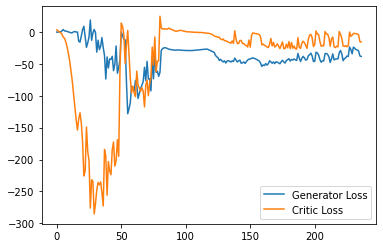

Step 4800: Generator loss: -28.661564579010008, critic loss: -7.900091366291044


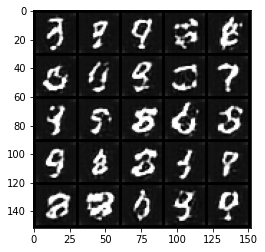

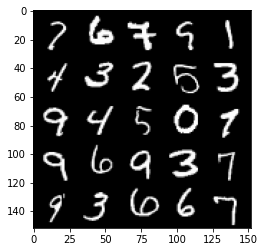

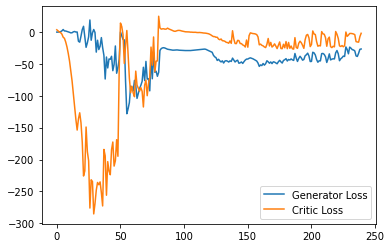

Step 4850: Generator loss: -22.501877899169923, critic loss: -2.5608885655403135


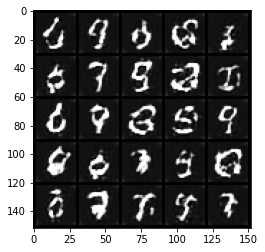

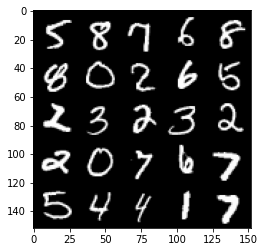

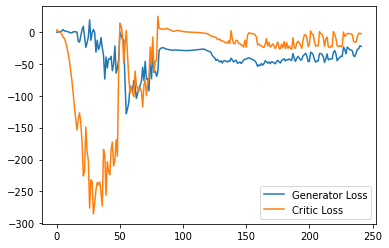

Step 4900: Generator loss: -30.24311279296875, critic loss: -10.426036307811737


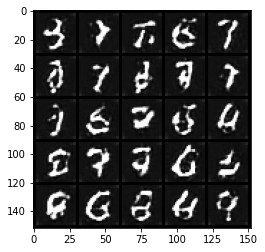

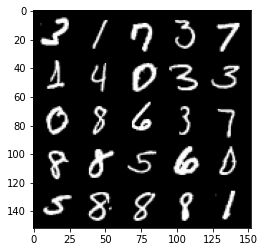

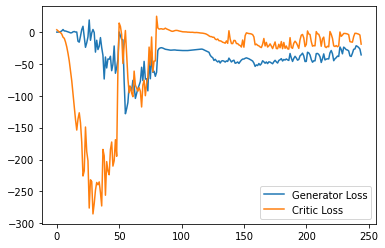

Step 4950: Generator loss: -30.659521465301513, critic loss: -19.08841938304901


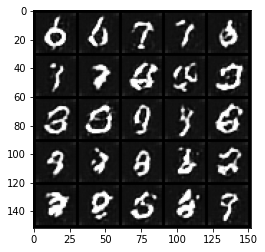

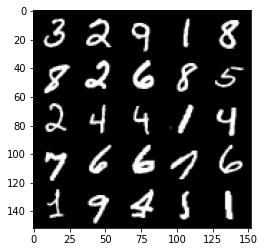

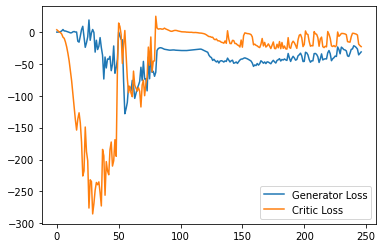

Step 5000: Generator loss: -23.90158082962036, critic loss: -10.893254062652588


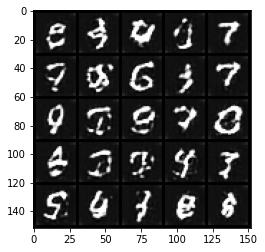

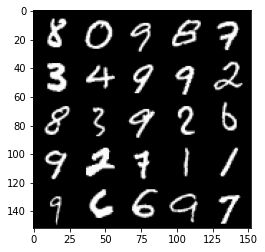

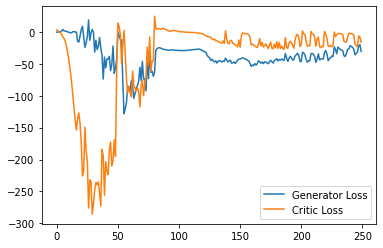

Step 5050: Generator loss: -28.276428661346436, critic loss: -18.238560220241546


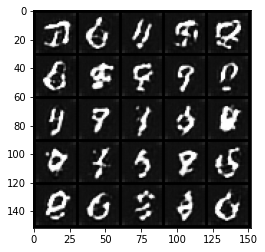

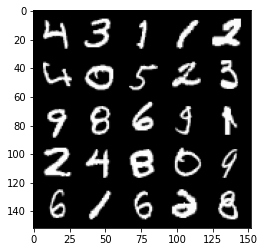

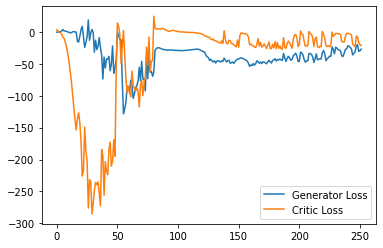

Step 5100: Generator loss: -26.975981941223143, critic loss: -18.857570990562444


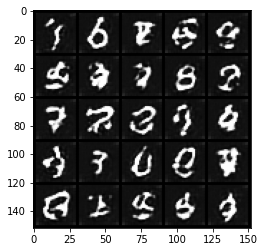

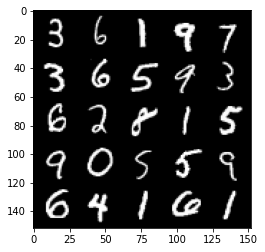

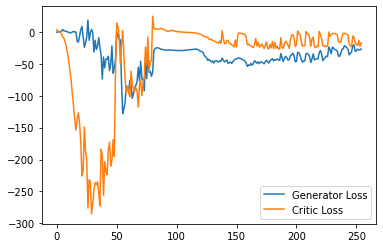

Step 5150: Generator loss: -22.217931728363038, critic loss: -13.092514444351195


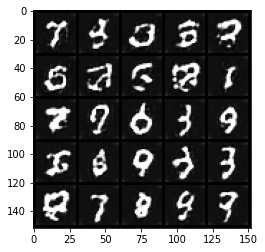

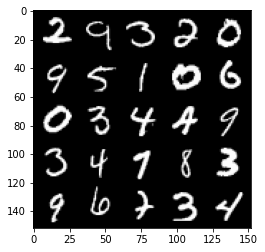

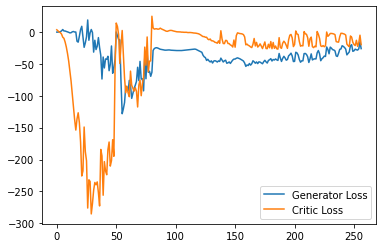

Step 5200: Generator loss: -26.1506330537796, critic loss: -20.831491034507753


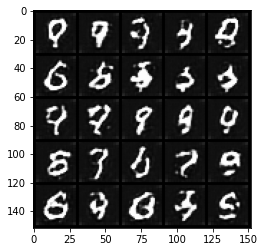

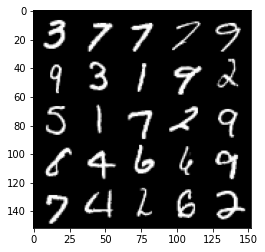

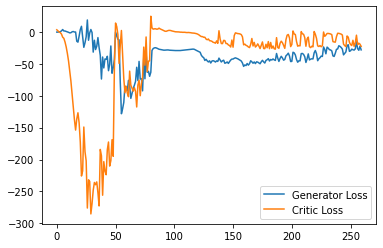

Step 5250: Generator loss: -21.92297351837158, critic loss: -12.968074820518494


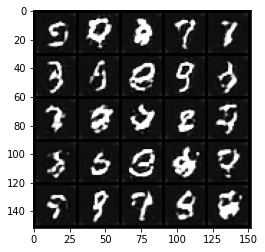

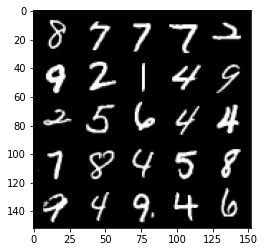

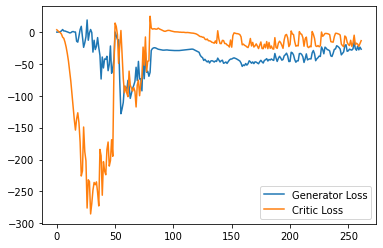

Step 5300: Generator loss: -12.000538330078125, critic loss: -4.178096085548401


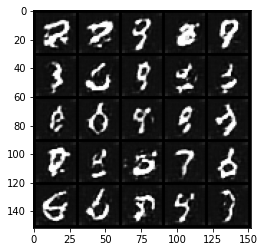

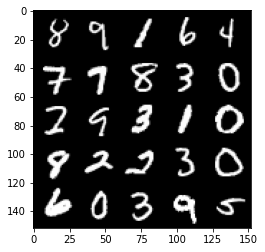

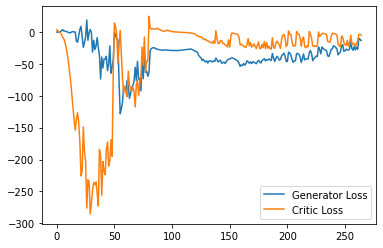

Step 5350: Generator loss: -22.77936580657959, critic loss: -17.15598886680603


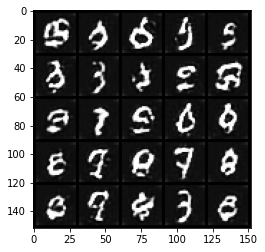

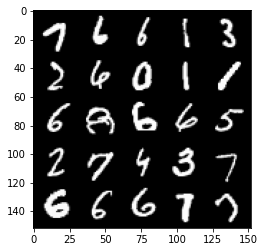

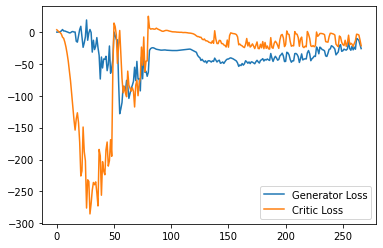

Step 5400: Generator loss: -20.305228567123415, critic loss: -8.286263882637025


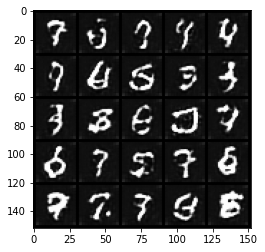

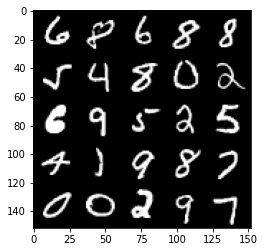

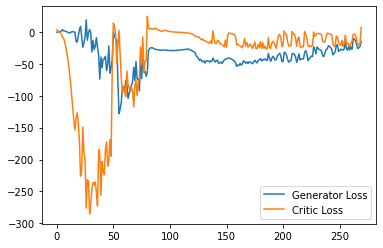

Step 5450: Generator loss: -10.556842041015624, critic loss: -2.2068628473281864


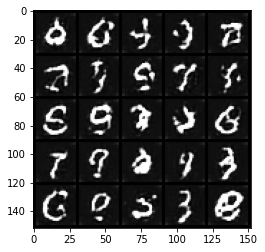

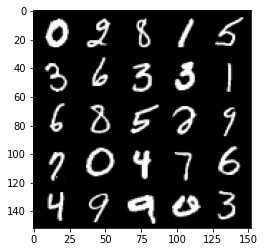

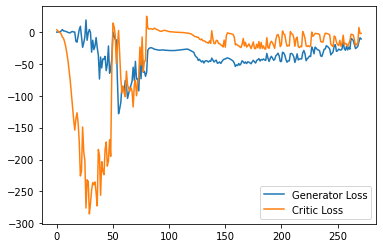

Step 5500: Generator loss: -14.177745857238769, critic loss: -2.4110360522270198


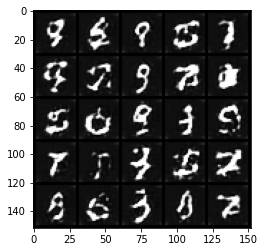

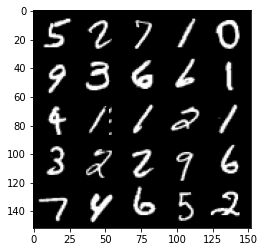

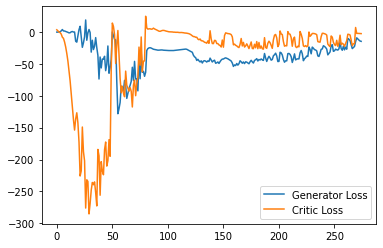

Step 5550: Generator loss: -16.76052083969116, critic loss: -3.0487848262786867


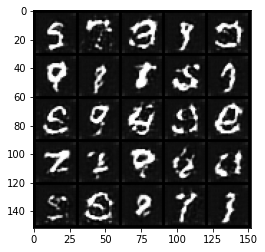

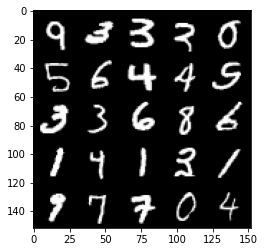

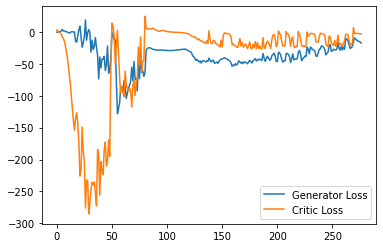

Step 5600: Generator loss: -22.193139915466308, critic loss: -9.432056770324708


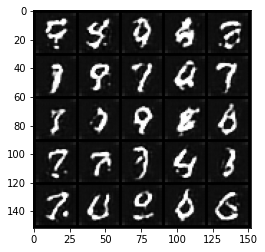

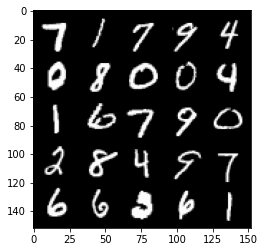

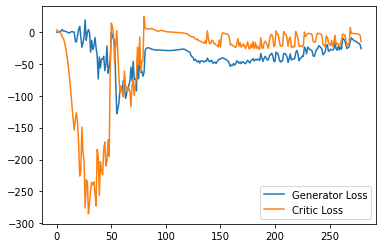

Step 5650: Generator loss: -19.550908088684082, critic loss: -9.22104827260971


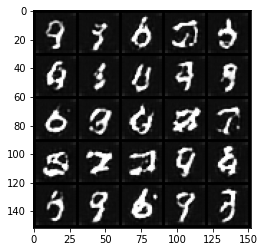

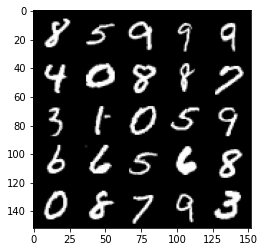

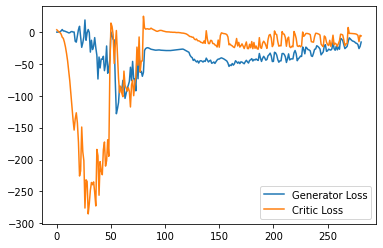

Step 5700: Generator loss: -19.101511936187745, critic loss: -12.87997617673874


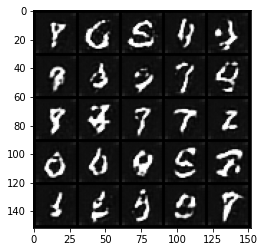

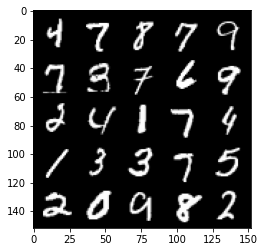

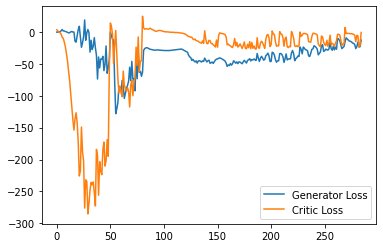

Step 5750: Generator loss: -10.61383791923523, critic loss: -6.191958119392394


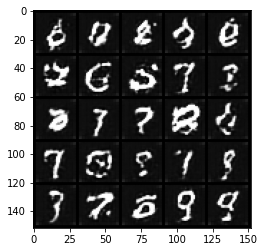

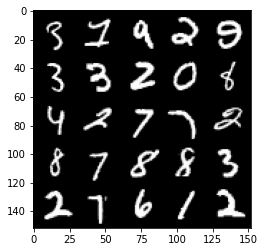

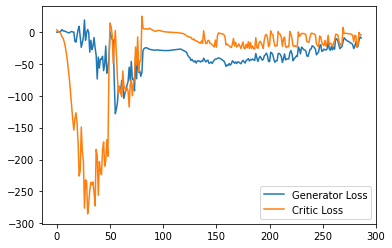

Step 5800: Generator loss: -18.86042413711548, critic loss: -10.98413178730011


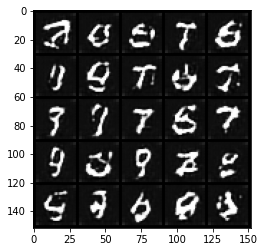

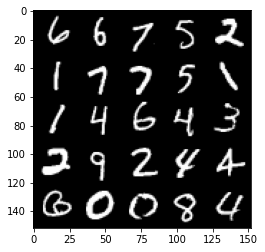

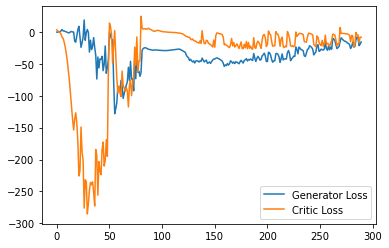

Step 5850: Generator loss: -21.118439426422118, critic loss: -21.029092626094823


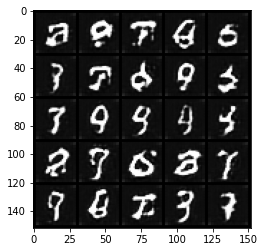

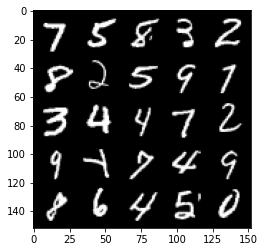

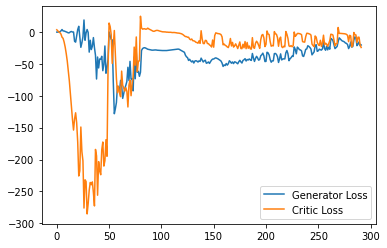

Step 5900: Generator loss: -18.376181073188782, critic loss: -20.7856446363926


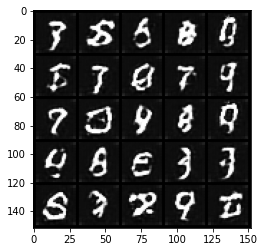

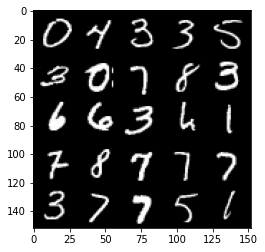

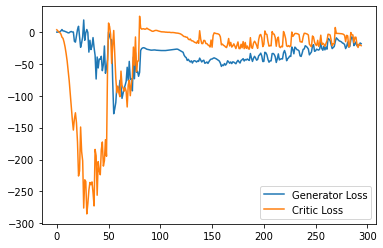

Step 5950: Generator loss: -15.388223042488098, critic loss: -14.796006961822512


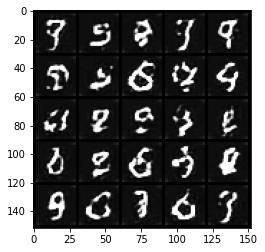

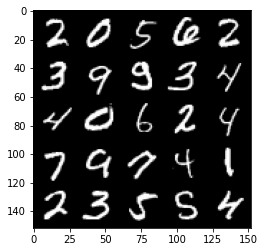

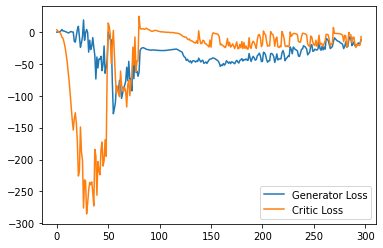

Step 6000: Generator loss: -16.08205634355545, critic loss: -19.648569924354558


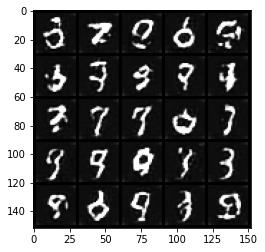

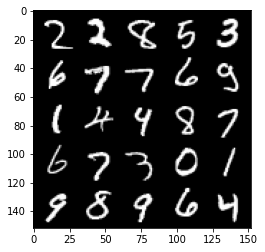

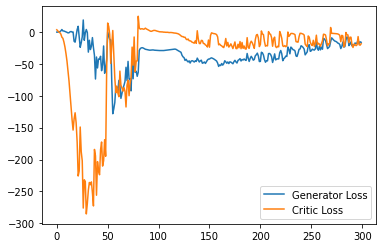

Step 6050: Generator loss: -15.452944476604461, critic loss: -21.104773147583003


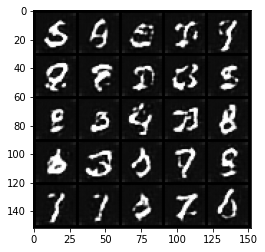

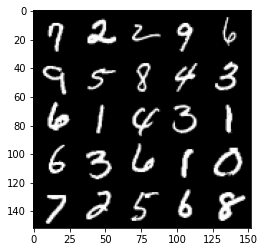

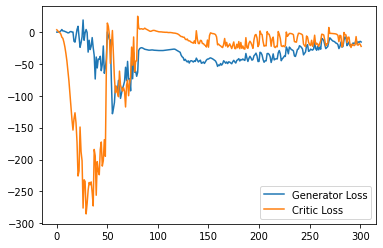

Step 6100: Generator loss: -2.4756463503837587, critic loss: 2.2792178707122797


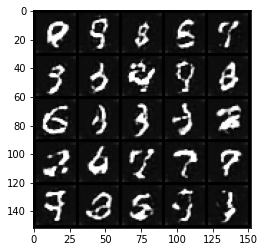

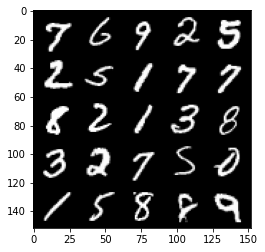

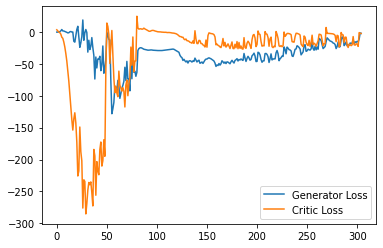

Step 6150: Generator loss: -4.394857535362243, critic loss: -2.294196535110474


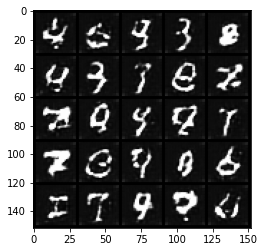

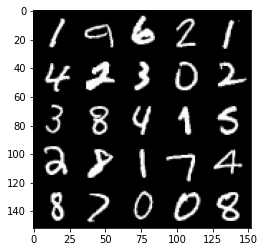

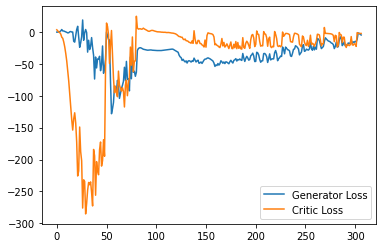

Step 6200: Generator loss: -6.500006256103515, critic loss: -2.431535232543945


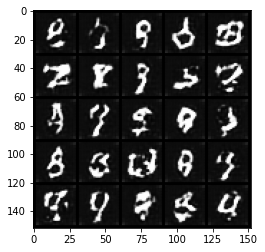

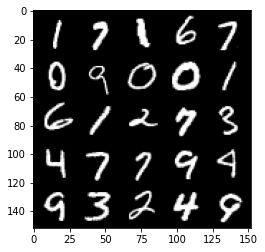

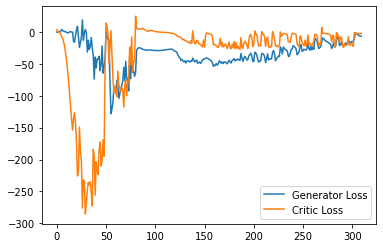

Step 6250: Generator loss: -8.161599550247193, critic loss: -2.73530207157135


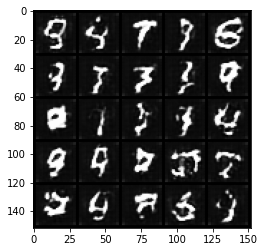

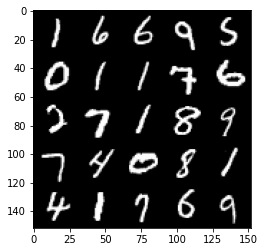

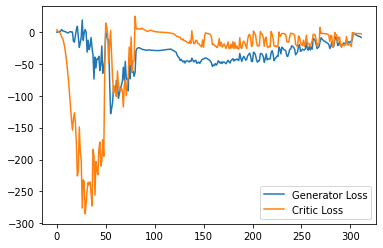

Step 6300: Generator loss: -12.49732931137085, critic loss: -6.553290346622467


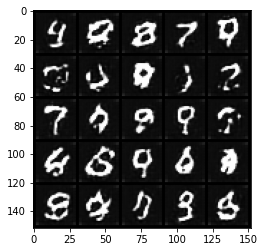

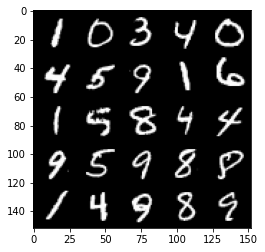

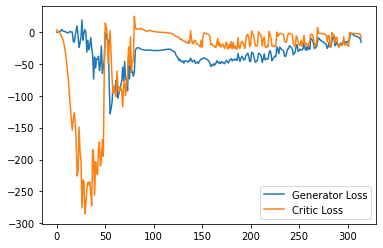

Step 6350: Generator loss: -13.198604168891906, critic loss: -7.774410333395


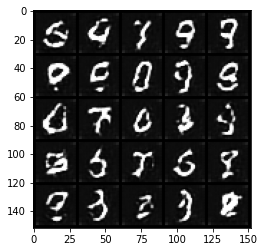

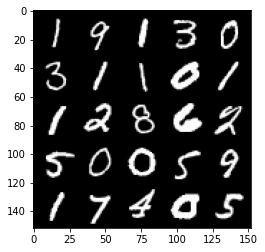

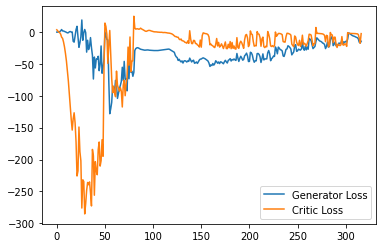

Step 6400: Generator loss: -2.1811036968231203, critic loss: -2.47494249534607


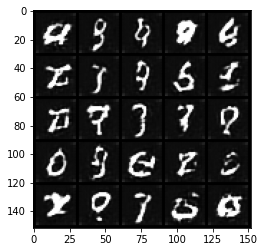

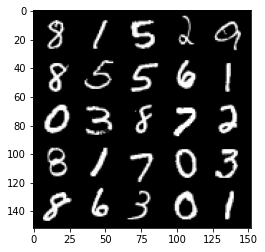

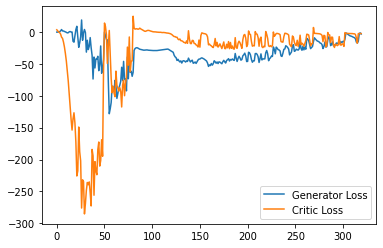

Step 6450: Generator loss: -4.615700316429138, critic loss: -2.5798707361221314


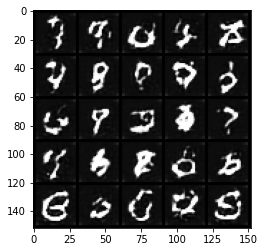

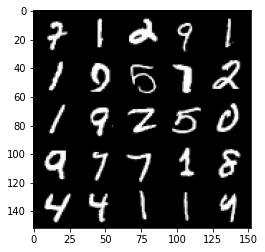

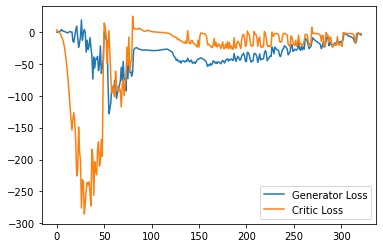

Step 6500: Generator loss: -7.254655818939209, critic loss: -3.065747027397155


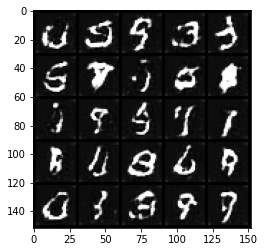

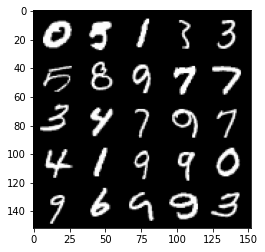

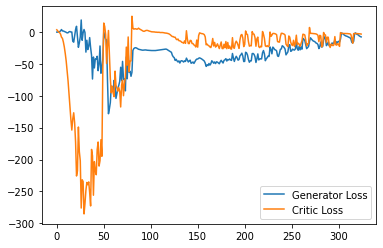

Step 6550: Generator loss: -10.251822018623352, critic loss: -3.7078434572219847


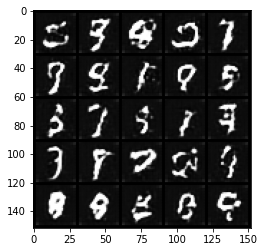

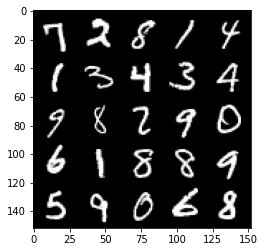

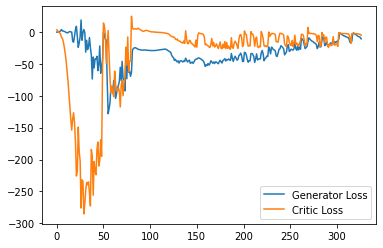

Step 6600: Generator loss: -8.469502229690551, critic loss: -2.5375790176391604


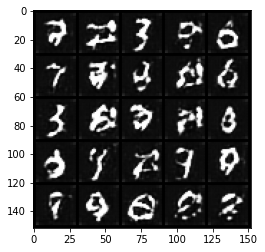

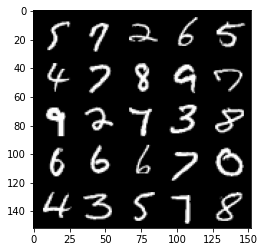

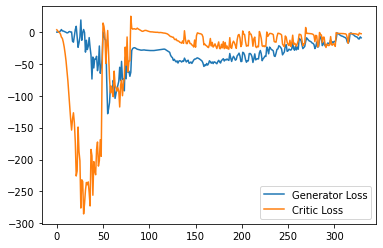

Step 6650: Generator loss: -13.464602229595185, critic loss: -8.100621916770935


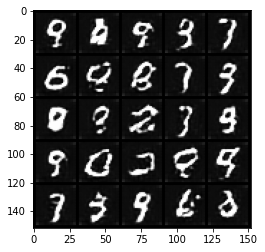

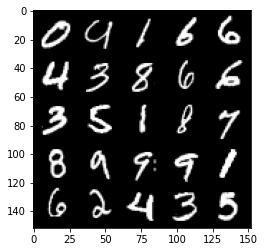

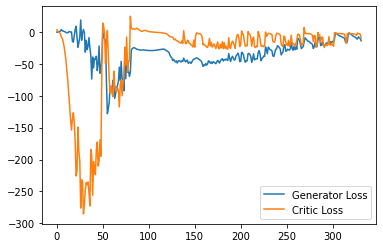

Step 6700: Generator loss: -5.509225413799286, critic loss: -5.361504033088684


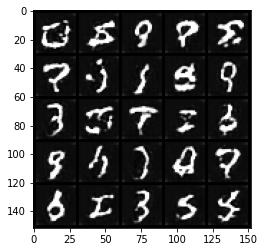

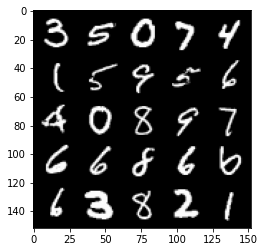

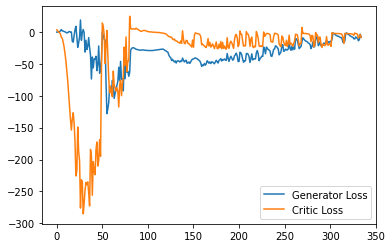

Step 6750: Generator loss: -13.92970094203949, critic loss: -18.008500490188602


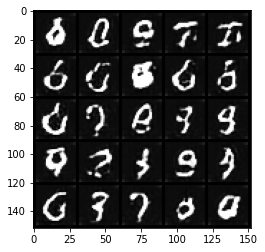

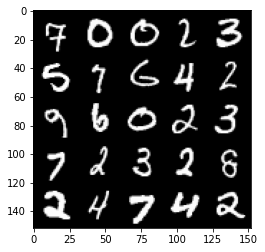

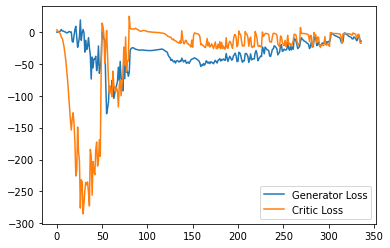

Step 6800: Generator loss: -9.8386651968956, critic loss: -14.363549934625624


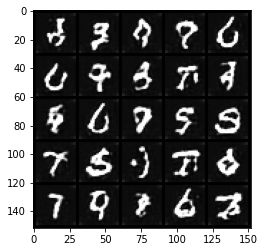

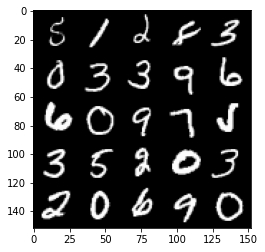

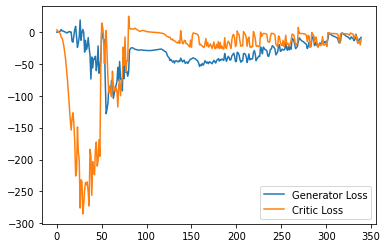

Step 6850: Generator loss: -8.279712389111518, critic loss: -20.330656056404113


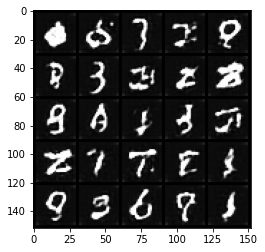

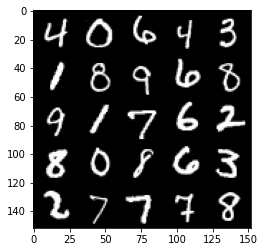

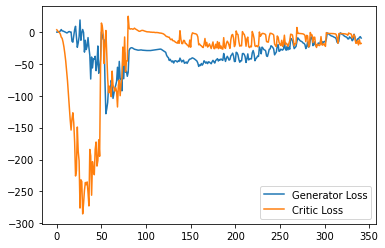

Step 6900: Generator loss: -10.137831931114198, critic loss: -16.598802878856656


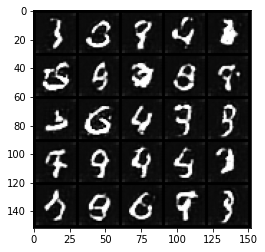

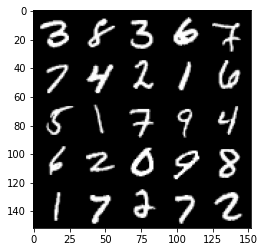

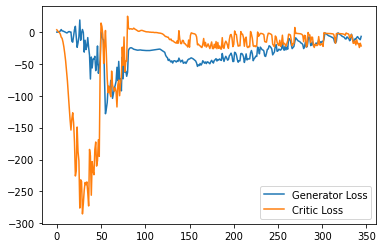

Step 6950: Generator loss: 1.2204617404937743, critic loss: -5.242694060325623


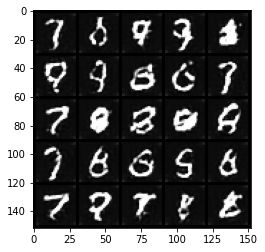

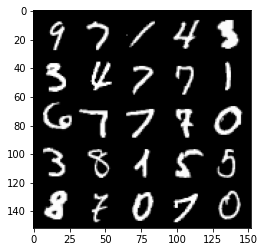

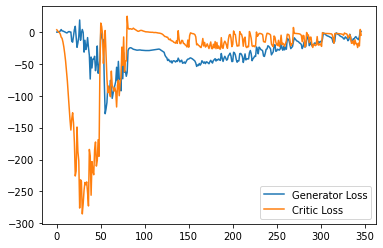

Step 7000: Generator loss: -2.6363019406795503, critic loss: -1.0187112431526193


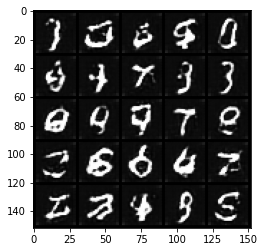

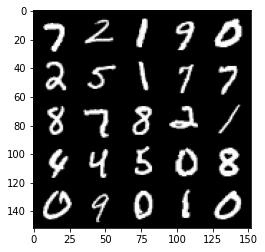

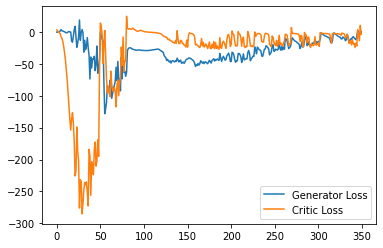

Step 7050: Generator loss: -0.054610343426465986, critic loss: -4.111421137332917


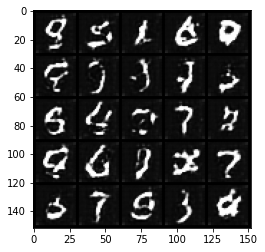

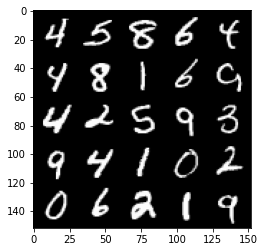

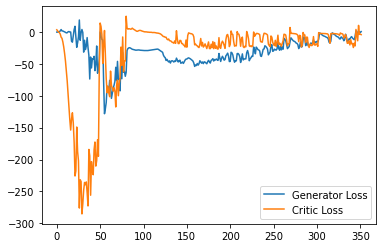

Step 7100: Generator loss: -6.084607607722282, critic loss: -11.682905193567278


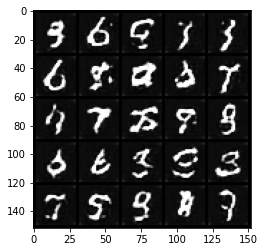

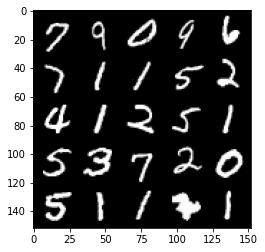

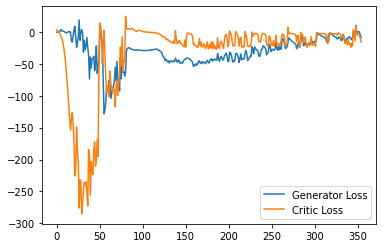

Step 7150: Generator loss: -7.584922435283661, critic loss: -18.36771128988266


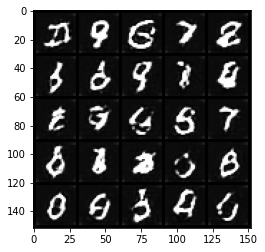

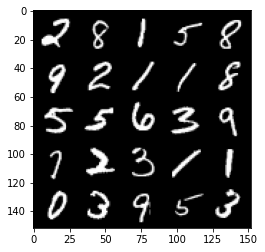

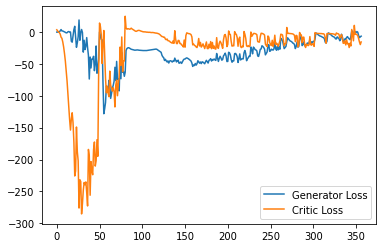

Step 7200: Generator loss: -1.331523990035057, critic loss: -14.350299474716184


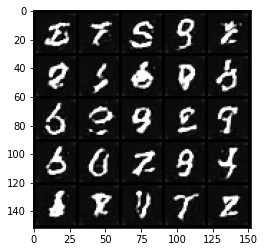

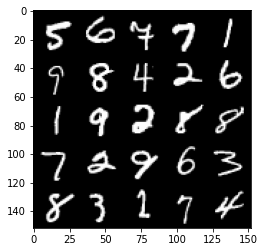

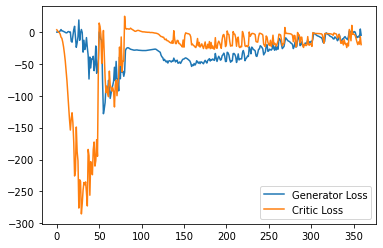

Step 7250: Generator loss: 0.030744889974594115, critic loss: -11.079311273097996


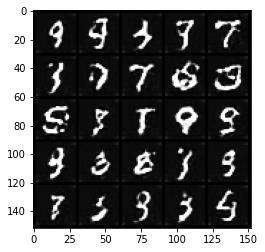

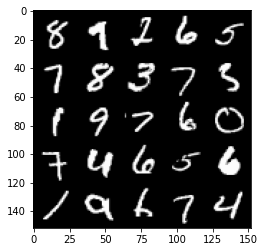

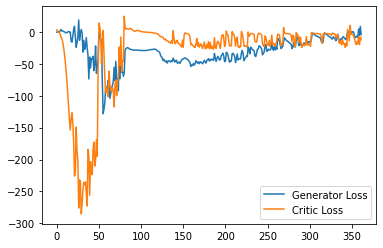

Step 7300: Generator loss: 1.5935114812850952, critic loss: -14.537925407409668


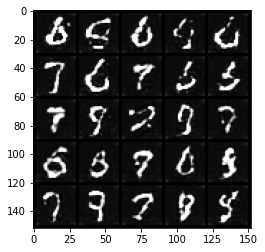

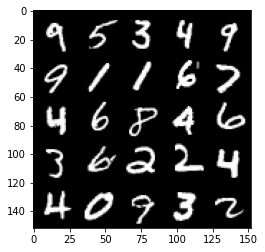

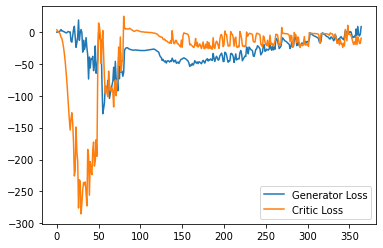

Step 7350: Generator loss: -1.1821274381875992, critic loss: -12.647010638237


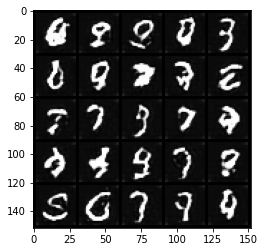

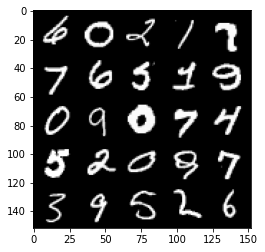

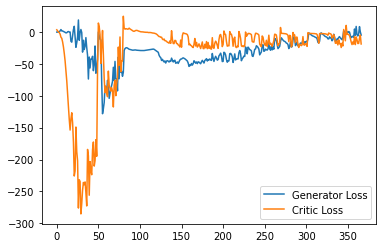

Step 7400: Generator loss: -3.344269380569458, critic loss: -22.335243573665622


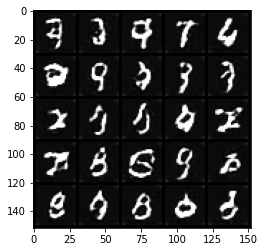

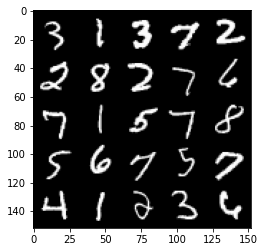

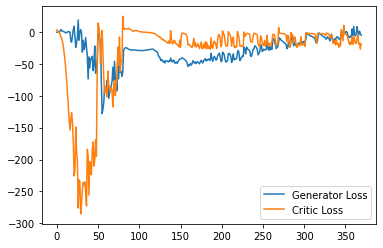

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
